Filtering DataFrame...
Number of unique users: 109227
Number of unique hashtags: 1503
Creating graph...
Added vertices...
Computing edges...
Adding edges...
Number of vertices:  110730
Number of edges:  1207739
Finding communities...
Number of communities:  16


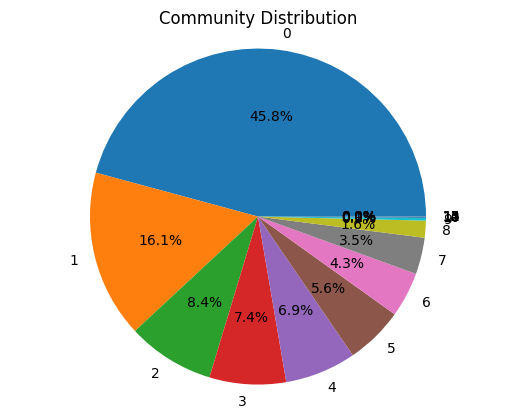

In [40]:
import os, yerbamate, ipdb
import pandas as pd
import igraph as ig
import leidenalg as la
import matplotlib.pyplot as plt

env = yerbamate.Environment()

path = os.path.join(env["plots"], "analysis", "user_hashtag_before.parquet")

df = pd.read_parquet(path)


df_after = pd.read_parquet(os.path.join(env['plots'], 'analysis', 'user_hashtag_after.parquet'))


hashtags_path = os.path.join(env['save'], 'hashtags', 'top_hashtag_before.csv')

print("Filtering DataFrame...")

# hashtag_counts = df.groupby("hashtag").size().reset_index(name="counts")
top_hashtags = pd.read_csv(hashtags_path)


# replace zero with 1
# top_hashtags["weight"] = top_hashtags["weight"] * 2 + 1

# times 2 if not 1 or 0
top_hashtags["weight"] = top_hashtags["weight"].apply(lambda x: x * 5 + 15 if x >= 1 else x + 1)

# top_hashtags["weight"] = top_hashtags["weight"] * 2 + 1

# drop weight 0 hashtags
top_hashtags = top_hashtags[top_hashtags["weight"] > 0]


# create a set of the top hashtags for faster lookup
top_hashtags_set = set(top_hashtags["hashtag"])

# filter the original DataFrame
df_filtered = df[df["hashtag"].isin(top_hashtags_set)]

df_unfiltered = df[df['userId'].isin(df_filtered['userId'])]
df = df_filtered

# prrint number of unique users and hashtags
print(f"Number of unique users: {len(df['userId'].unique())}")
print(f"Number of unique hashtags: {len(df['hashtag'].unique())}")

print("Creating graph...")
# initialize a new graph
g = ig.Graph(directed=False)
# g.add_vertex(n=len(df["userId"].unique()), type="user")
# g.add_vertex(n=len(df["hashtag"].unique()), type="hashtag")
user_size = len(df["userId"].unique())


g.add_vertices(n=len(df["userId"].unique()) + len(df["hashtag"].unique()))

# set name of hashtags to be the hashtag itself
g.vs[user_size:]["name"] = df["hashtag"].unique()

# Add types for vertices
g.vs["type"] = [True if i < user_size else False for i in range(g.vcount())]


print("Added vertices...")
# map users and hashtags to unique integers
user_mapping = {user: i for i, user in enumerate(df["userId"].unique())}
hashtag_mapping = {
    hashtag: i + len(user_mapping) for i, hashtag in enumerate(df["hashtag"].unique())
}

print("Computing edges...")
 

df["user_id"] = df["userId"].map(user_mapping)
df["hashtag_id"] = df["hashtag"].map(hashtag_mapping)
top_hashtags["hashtag_id"] = top_hashtags["hashtag"].map(hashtag_mapping)

df_unfiltered["user_id"] = df_unfiltered["userId"].map(user_mapping)
df_unfiltered["hashtag_id"] = df_unfiltered["hashtag"].map(hashtag_mapping)

#df['weight'] = df['hashtag_id'].map(lambda x: top_hashtags[top_hashtags['hashtag_id'] == x]['weight'].values[0])

# create the list of edges
edges = list(zip(df["user_id"], df["hashtag_id"]))

# weight is the weight in top_hashtags dataframe, where as if the edge ends with hashtag_id, the weight is the top_hashtags['hashtag'] weight
#weights = [top_hashtags[top_hashtags['hashtag_id'] == x[1]]['weight'].values[0] for x in edges]
# edges.map(lambda x: top_hashtags[top_hashtags['hashtag_id'] == x[1]]['weight'])
hashtag_id_to_weight = top_hashtags.set_index('hashtag_id')['weight'].to_dict()
weights = [hashtag_id_to_weight[x[1]] for x in edges]

print("Adding edges...")

g.add_edges(edges)

# weights = df["count"].values

# normalize the weights
# weights = weights / weights.max()

g.es["weight"] = weights


# # add the edges with weights
# g.es["weight"] = weightsu

# # add the edges with weights
# g.es['weight'] = weights
print("Number of vertices: ", len(g.vs))
print("Number of edges: ", len(g.es))

print("Finding communities...")


# get the partition using the Leiden algorithm
import leidenalg as la

partition = la.find_partition(g, la.ModularityVertexPartition, weights= weights, n_iterations=10)#g.es["weight"])

print("Number of communities: ", len(partition))

# add the partition to the graph
g.vs["partition"] = partition.membership

df['community'] =  df['user_id'].map( lambda x: g.vs[x]['partition'])


# df after has differet size, we only want to keep people that are in the graph
df_after = df_after[df_after['userId'].isin(df['userId'].unique())]

df_after["user_id"] = df_after["userId"].map(user_mapping)
# df_after["hashtag_id"] = df_after["hashtag"].map(hashtag_mapping)

df_after['community'] = df_after['user_id'].map( lambda x: g.vs[x]['partition'])
df_unfiltered['community'] = df_unfiltered['user_id'].map( lambda x: g.vs[x]['partition'])

# Get the community sizes
community_sizes = partition.sizes()

# Plot the pie chart
plt.pie(community_sizes, labels=range(len(community_sizes)), autopct='%1.1f%%')
plt.title('Community Distribution')
plt.axis('equal')

# Show the chart
plt.show()

In [35]:
# loading graph

import igraph as ig
import os, yerbamate, pandas as pd

env = yerbamate.Environment()
graph_save_path = os.path.join(env['save'], 'graph', 'hashtag_communities', 'hashtag_communities_bipart_0finetune.graphml')


path = os.path.join(env["plots"], "analysis", "user_hashtag_before.parquet")

df = pd.read_parquet(path)


df_after = pd.read_parquet(os.path.join(env['plots'], 'analysis', 'user_hashtag_after.parquet'))


hashtags_path = os.path.join(env['save'], 'hashtags', 'top_hashtag_before.csv')

print("Filtering DataFrame...")

# hashtag_counts = df.groupby("hashtag").size().reset_index(name="counts")
top_hashtags = pd.read_csv(hashtags_path)


# replace zero with 1
# top_hashtags["weight"] = top_hashtags["weight"] * 2 + 1

# times 2 if not 1 or 0
top_hashtags["weight"] = top_hashtags["weight"].apply(lambda x: x * 5 + 10 if x >= 1 else x + 1)
# create a set of the top hashtags for faster lookup
top_hashtags_set = set(top_hashtags["hashtag"])

# filter the original DataFrame
df_filtered = df[df["hashtag"].isin(top_hashtags_set)]

df_unfiltered = df[df['userId'].isin(df_filtered['userId'])]

df = df_filtered


# prrint number of unique users and hashtags
print(f"Number of unique users: {len(df['userId'].unique())}")
print(f"Number of unique hashtags: {len(df['hashtag'].unique())}")

print("Loading graph...")

g = ig.Graph.Read_GraphML(graph_save_path)

# map users and hashtags to unique integers
user_mapping = {user: i for i, user in enumerate(df["userId"].unique())}
hashtag_mapping = {
    hashtag: i + len(user_mapping) for i, hashtag in enumerate(df["hashtag"].unique())
}

  

df["user_id"] = df["userId"].map(user_mapping)
df["hashtag_id"] = df["hashtag"].map(hashtag_mapping)

df['community'] = df['user_id'].map( lambda x: g.vs[x]['partition'])


# df after has differet size, we only want to keep people that are in the graph
df_after = df_after[df_after['userId'].isin(df['userId'].unique())]

df_after["user_id"] = df_after["userId"].map(user_mapping)
# df_after["hashtag_id"] = df_after["hashtag"].map(hashtag_mapping)

df_after['community'] = df_after['user_id'].map( lambda x: g.vs[x]['partition'])
df_unfiltered['user_id'] = df_unfiltered['userId'].map(user_mapping)
df_unfiltered['community'] = df_unfiltered['user_id'].map( lambda x: g.vs[x]['partition'])
df_unfiltered['hashtag_id'] = df_unfiltered['hashtag'].map(hashtag_mapping)


Filtering DataFrame...
Number of unique users: 109227
Number of unique hashtags: 1503
Loading graph...


Community distribution statistics: 
[55885, 15255, 9201, 7765, 7532, 6165, 4930, 1809, 1761, 288, 125, 6, 2, 2, 2, 2]


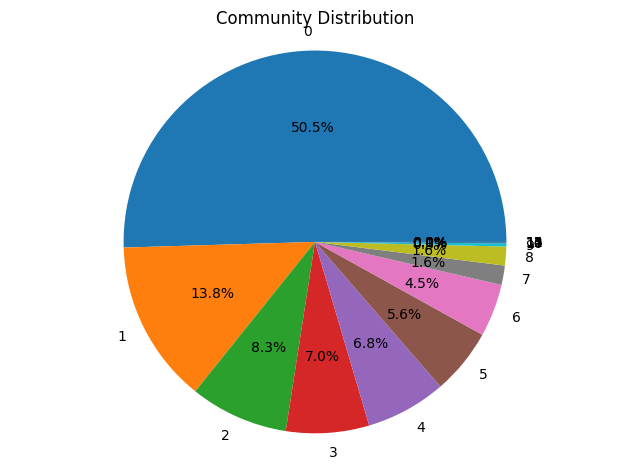

In [28]:
# Plot the pie chart
plt.pie(community_sizes, labels=range(len(community_sizes)), autopct='%1.1f%%')
plt.title('Community Distribution')
plt.axis('equal')

save_path_pie = os.path.join(env["plots"], "analysis", "community0_finetune", "community_pie.png")

if not os.path.exists(os.path.dirname(save_path_pie)):
    os.makedirs(os.path.dirname(save_path_pie))

# tight_layout() adjusts the subplot params so that the subplot(s) fits in to the figure area.
plt.tight_layout()

# remove the extra white space on the right side of the plot
# plt.subplots_adjust(right=1)
# plt.subplots_adjust(left=0.1, right=0.8, top=0.9, bottom=0.1)
plt.savefig(save_path_pie)

# print distribution statistics

print("Community distribution statistics: ")
print(community_sizes)

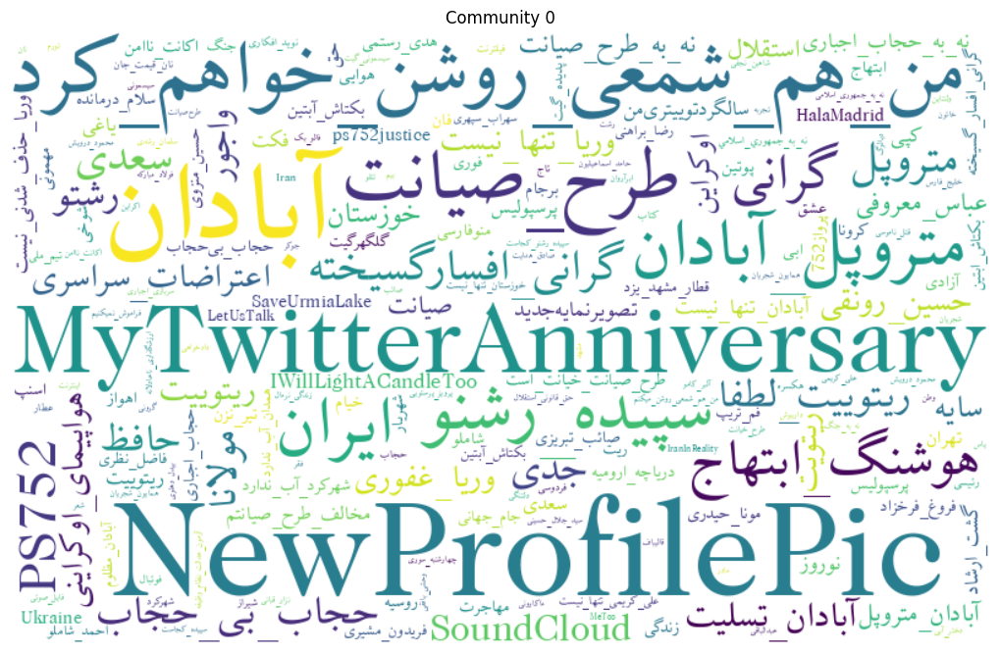

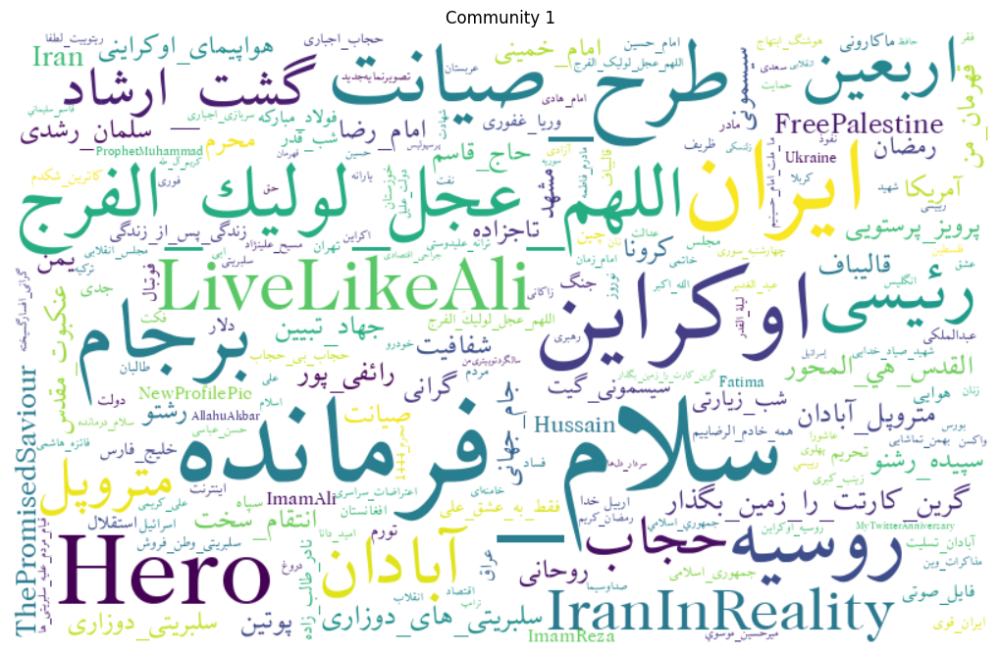

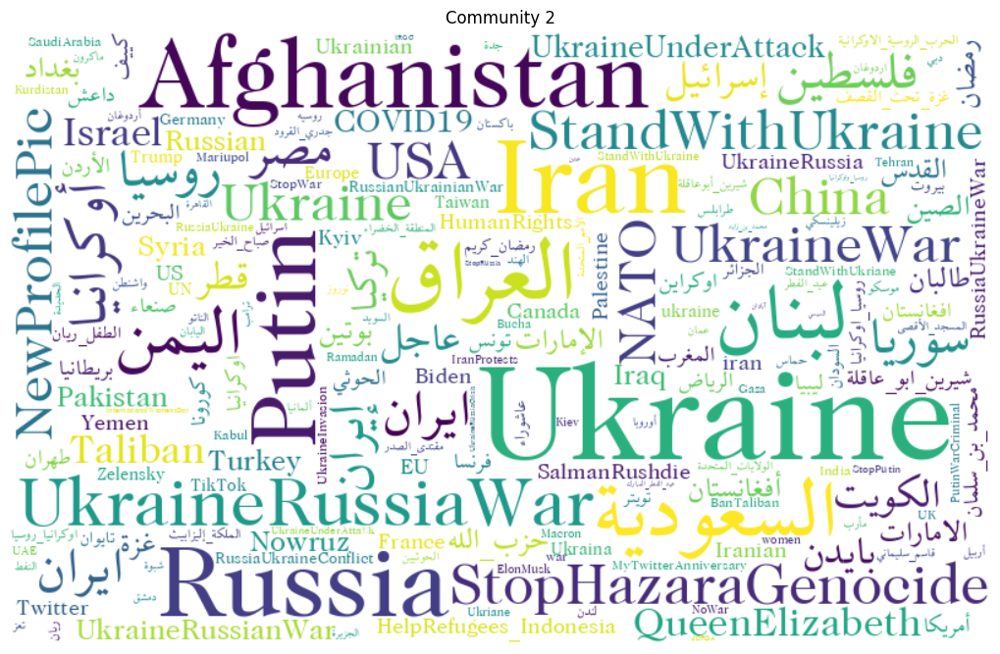

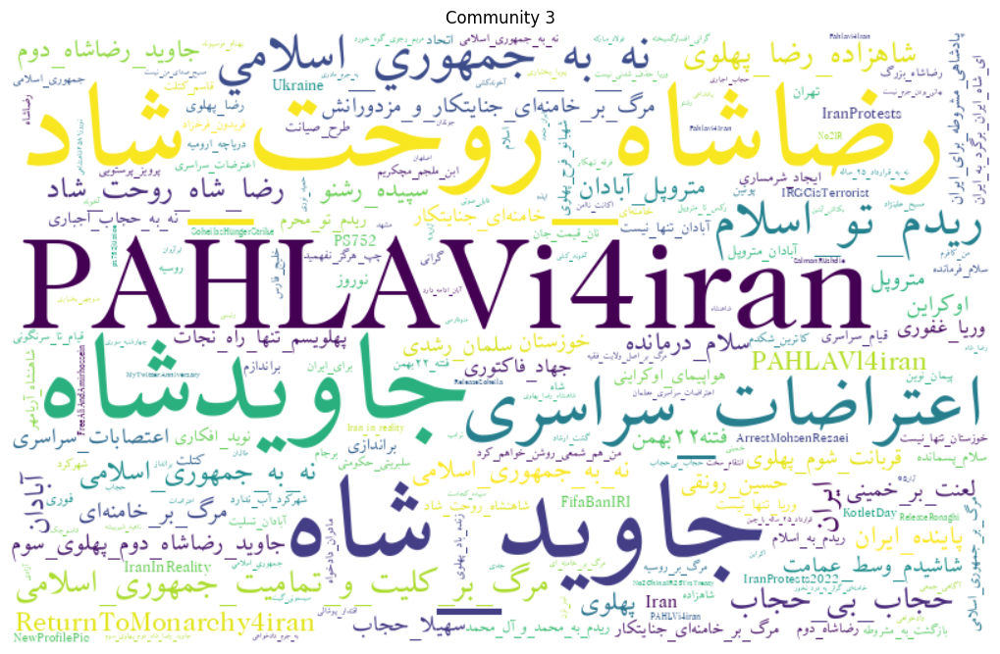

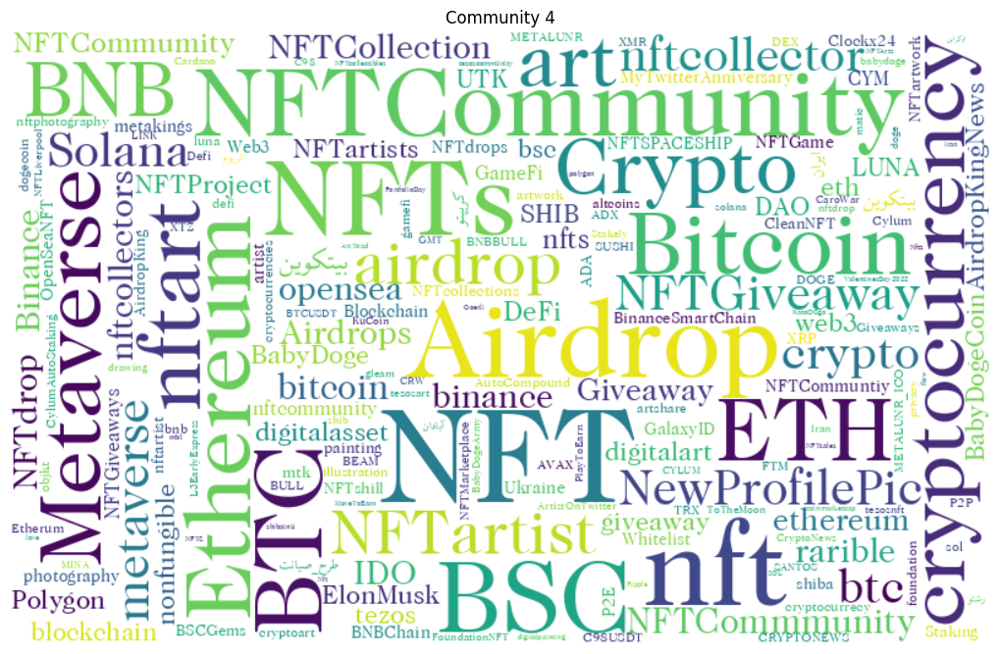

...

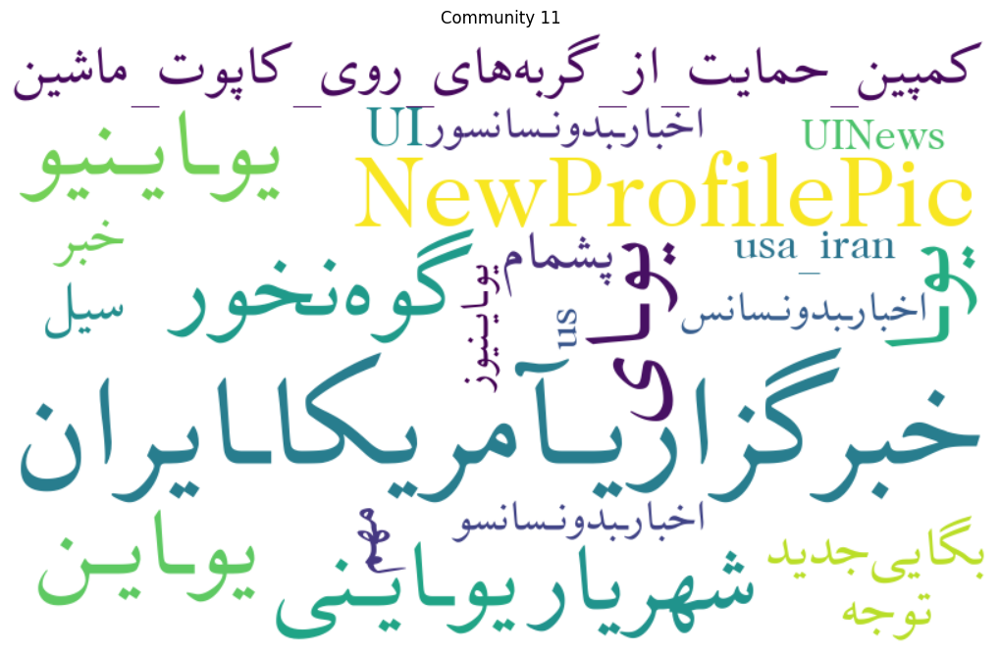

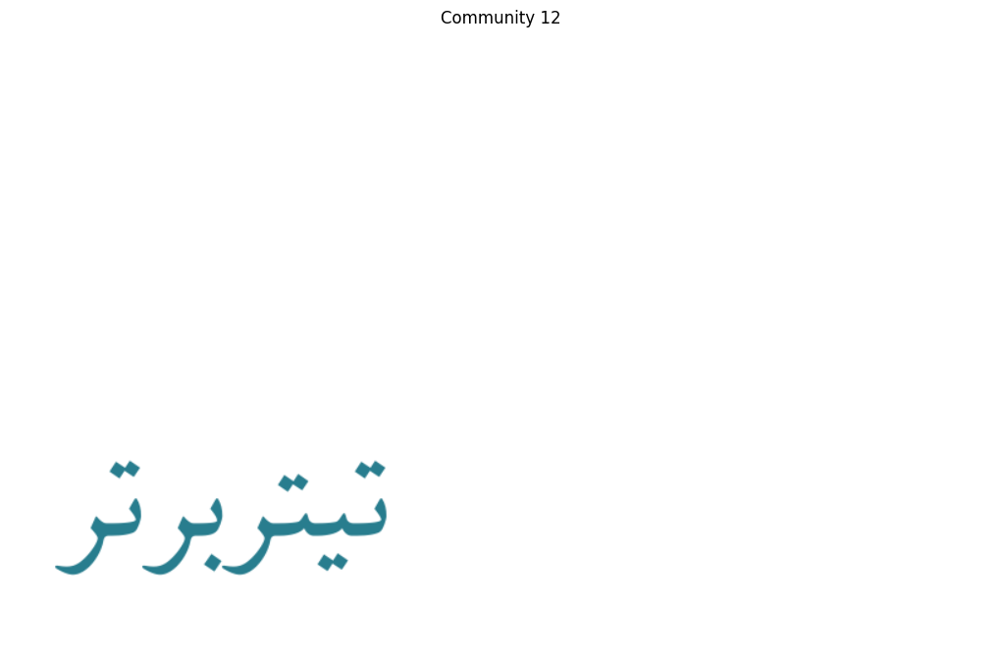

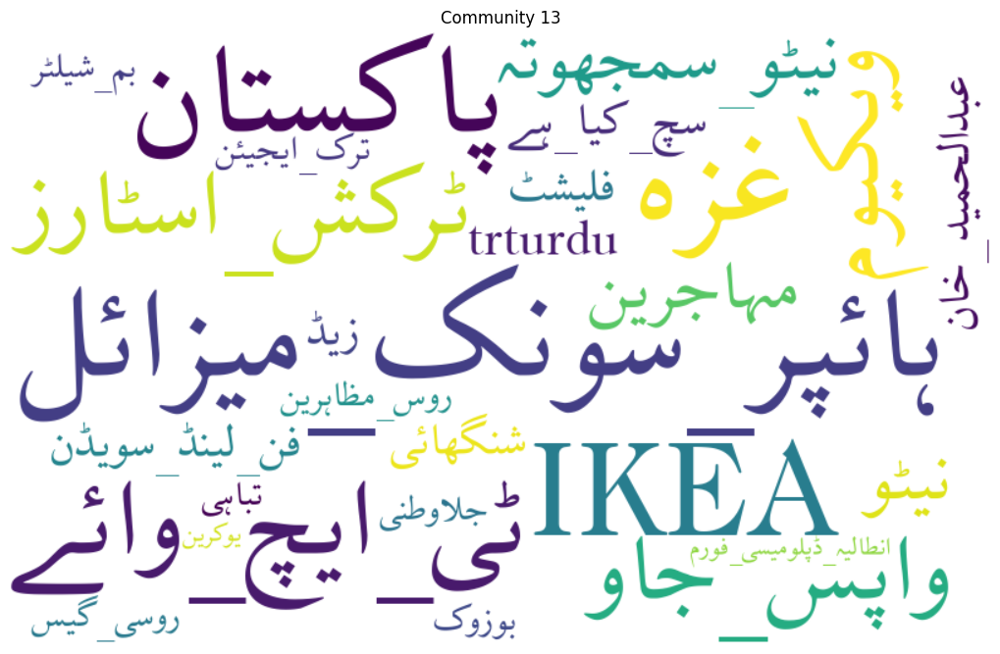

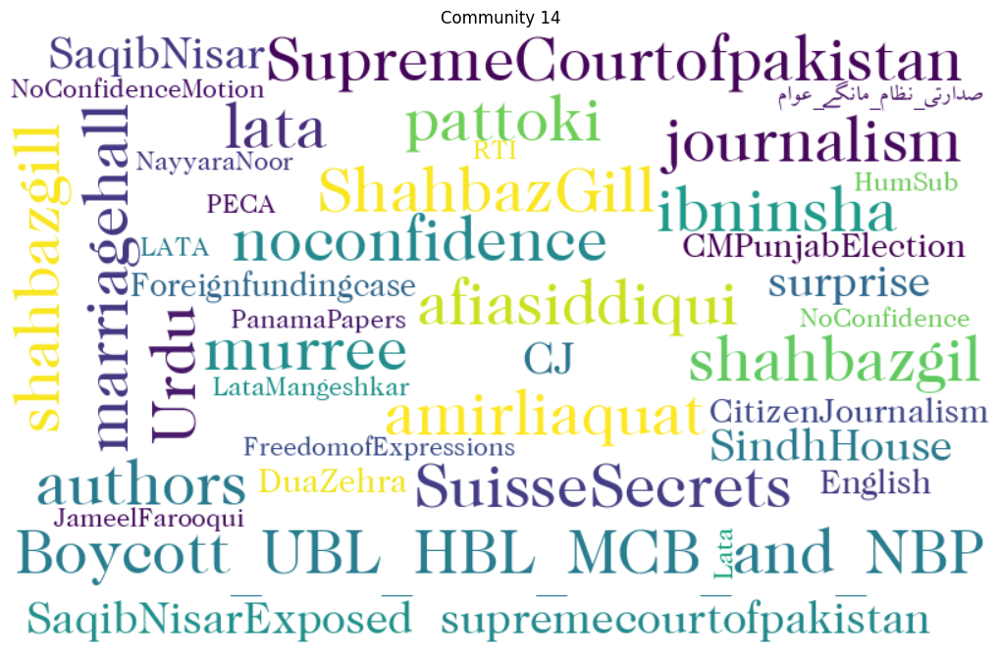

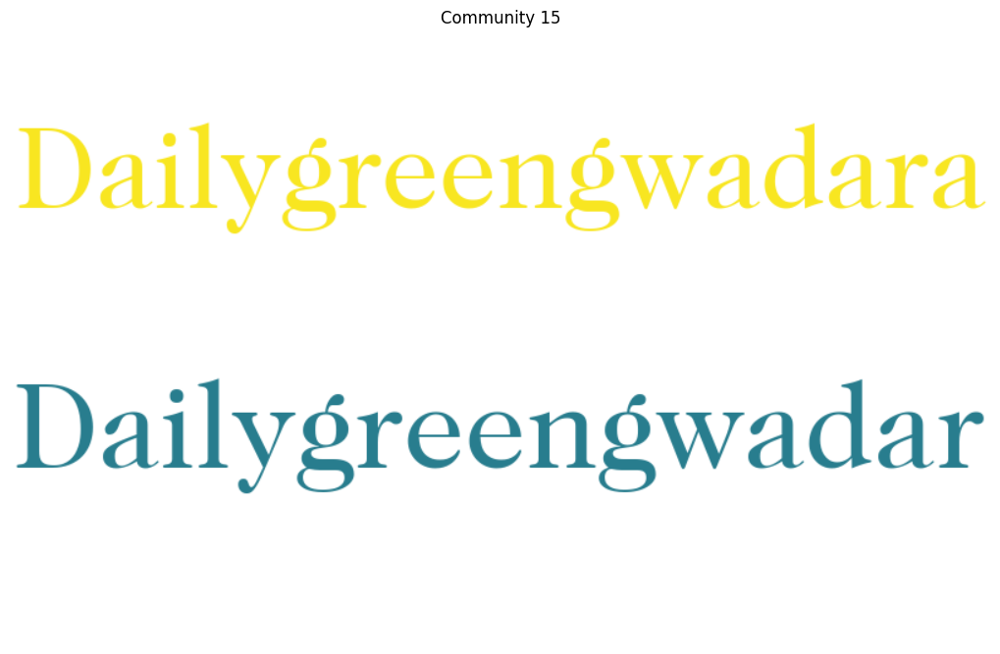

In [41]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib

matplotlib.rcParams["axes.unicode_minus"] = False
from bidi.algorithm import get_display
import arabic_reshaper

#df = df_after

# assuming `df` is your DataFrame and it has a 'community' column
for community in sorted(df["community"].unique()):
    subset = df_unfiltered[df_unfiltered["community"] == community]
    # print(subset.columns)
    # #freq = subset.groupby("hashtag").count() 
    # # text = get_display(arabic_reshaper.reshape(text))
    # print(subset.head())
    # if subset.empty:
    #     print(f"No hashtags for community {community}. Skipping...")
    #     continue

    freq = subset.groupby("hashtag")["user_id"].size()
    freq = freq.sort_values(ascending=False)
    freq = freq[:200]
    # print(freq)
    wordcloud = WordCloud(
        font_path="/usr/share/fonts/TTF/XB-Zar-Regular.ttf",
        width=800,
        height=500,
        random_state=21,
        max_font_size=110,
        background_color="white",
    ).generate_from_frequencies(freq)

    plt.figure(figsize=(10, 7))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Community {community}")
    # plt.show()
    save_cloud_path = os.path.join( env["plots"], "analysis", "community0_finetune", f"community_{community}.png")

    if not os.path.exists(os.path.dirname(save_cloud_path)):
        os.makedirs(os.path.dirname(save_cloud_path))

    # tight_layout() adjusts the subplot params so that the subplot(s) fits in to the figure area.
    plt.tight_layout()

    # remove the extra white space on the right side of the plot
    plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)
    
    #plt.show()
    plt.savefig(save_cloud_path)

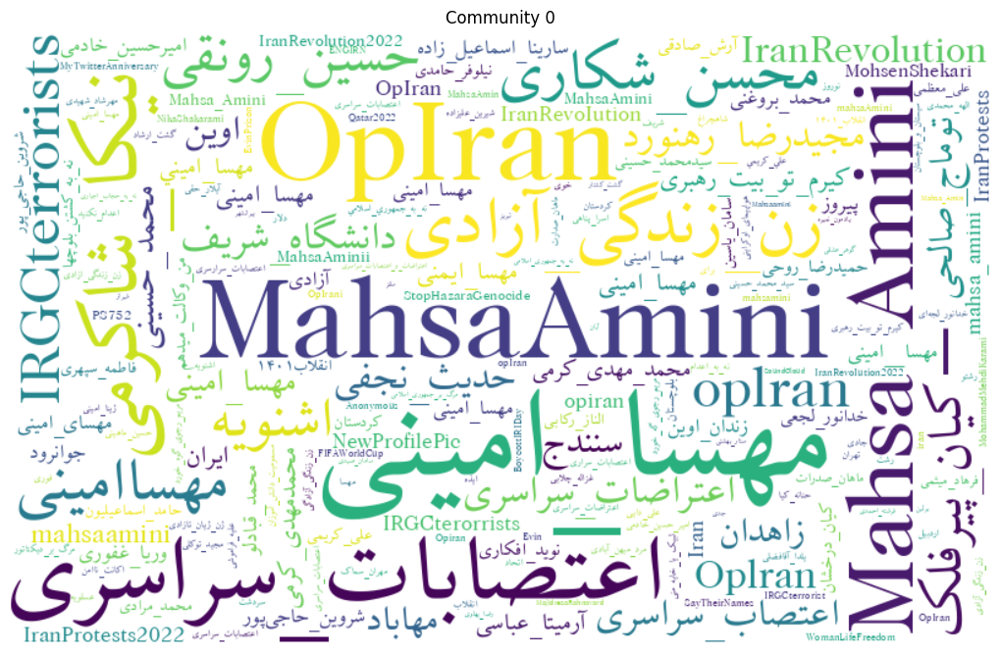

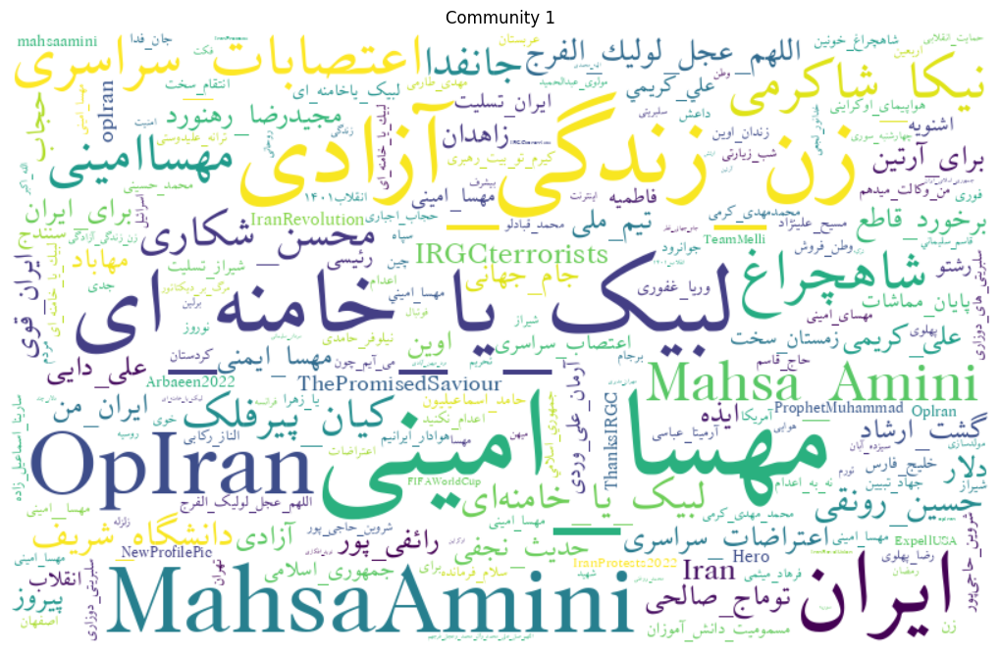

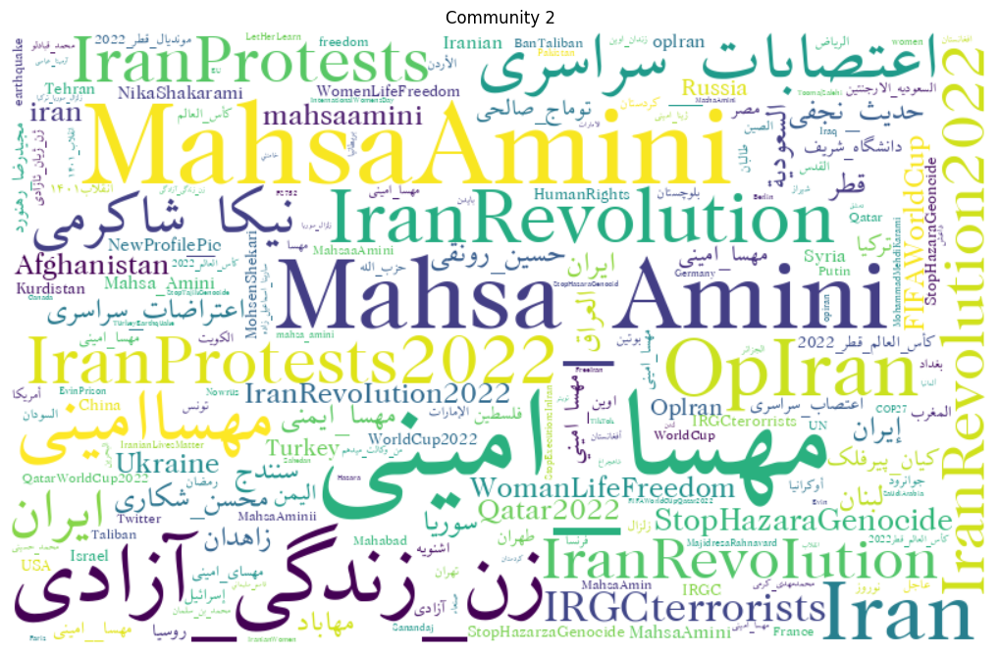

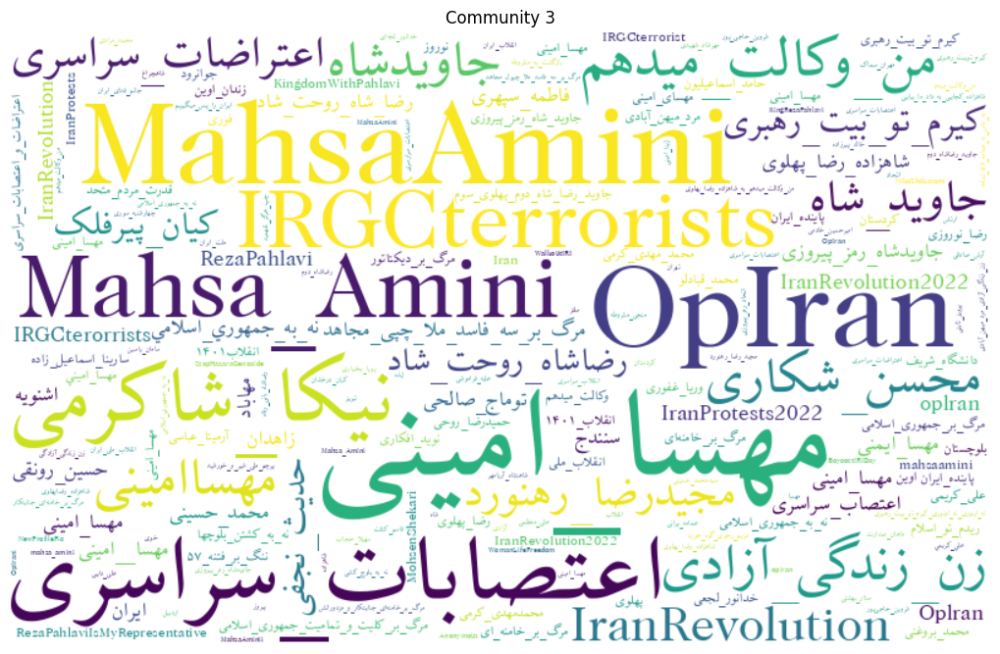

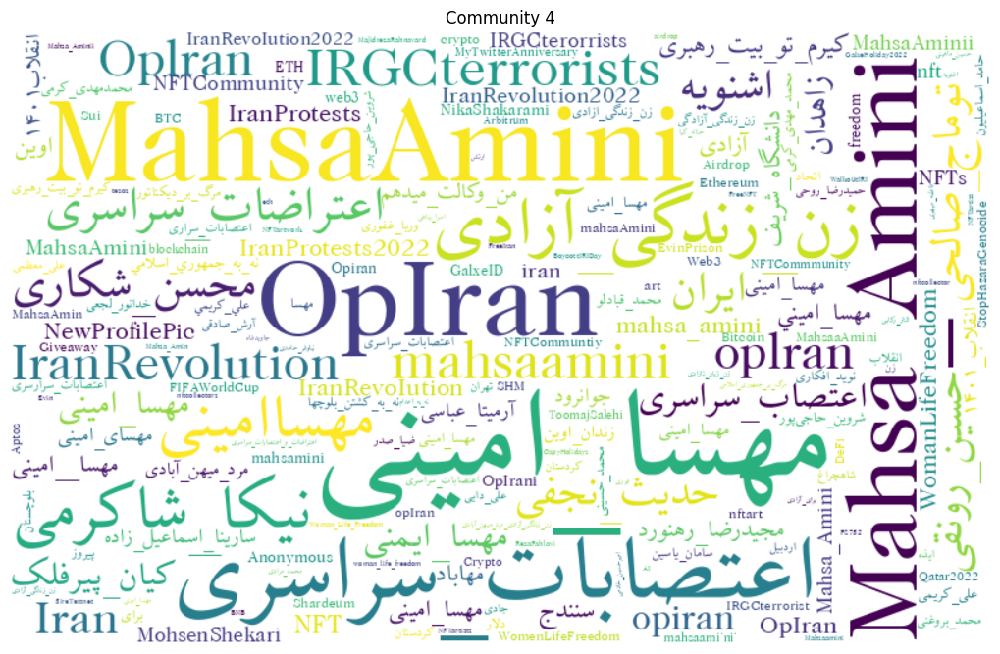

...

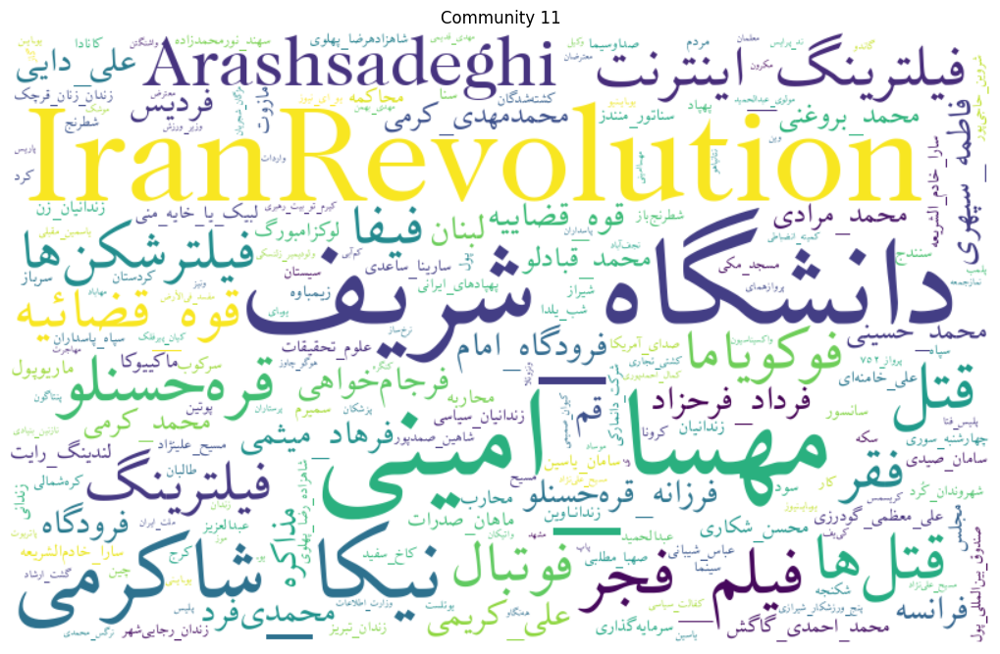

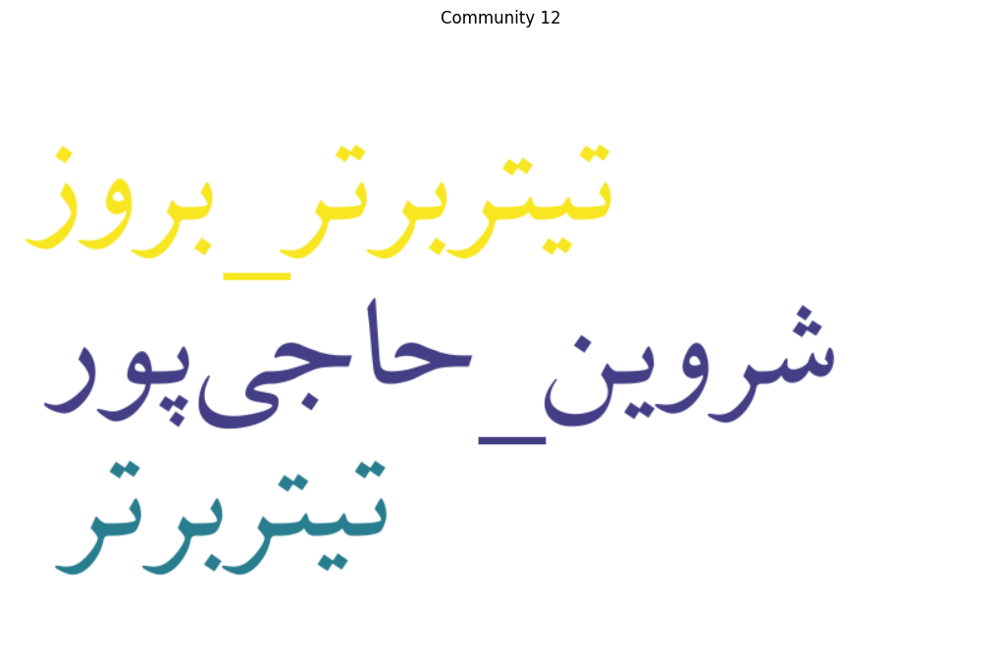

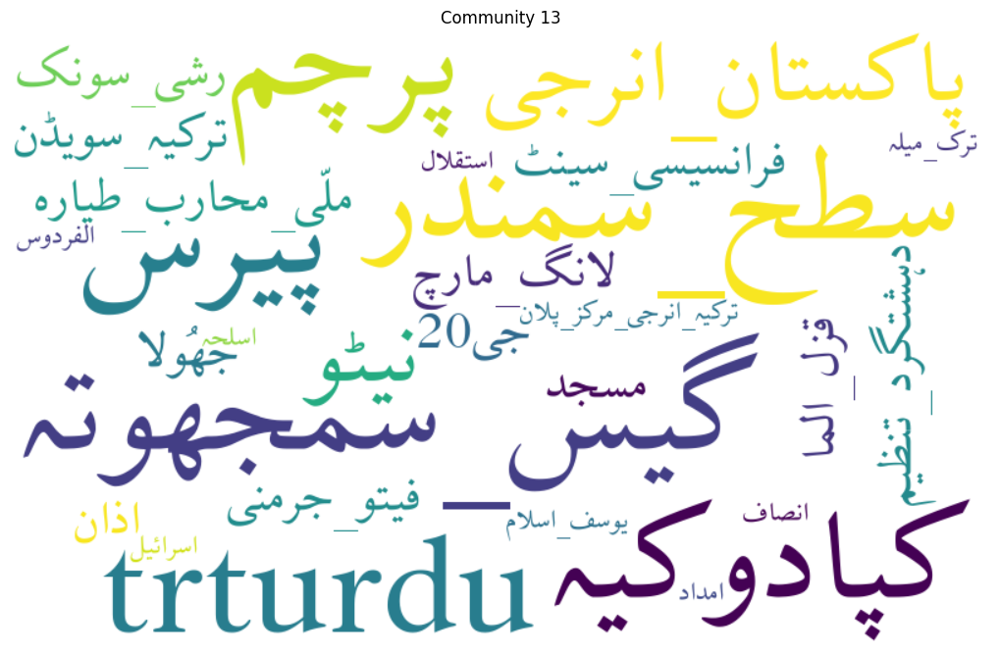

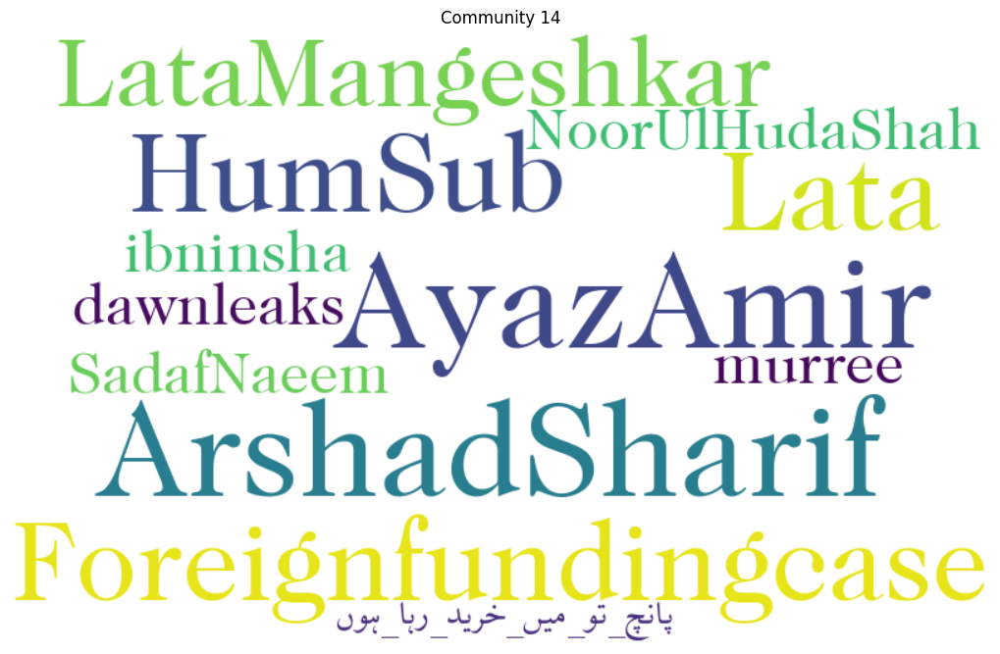

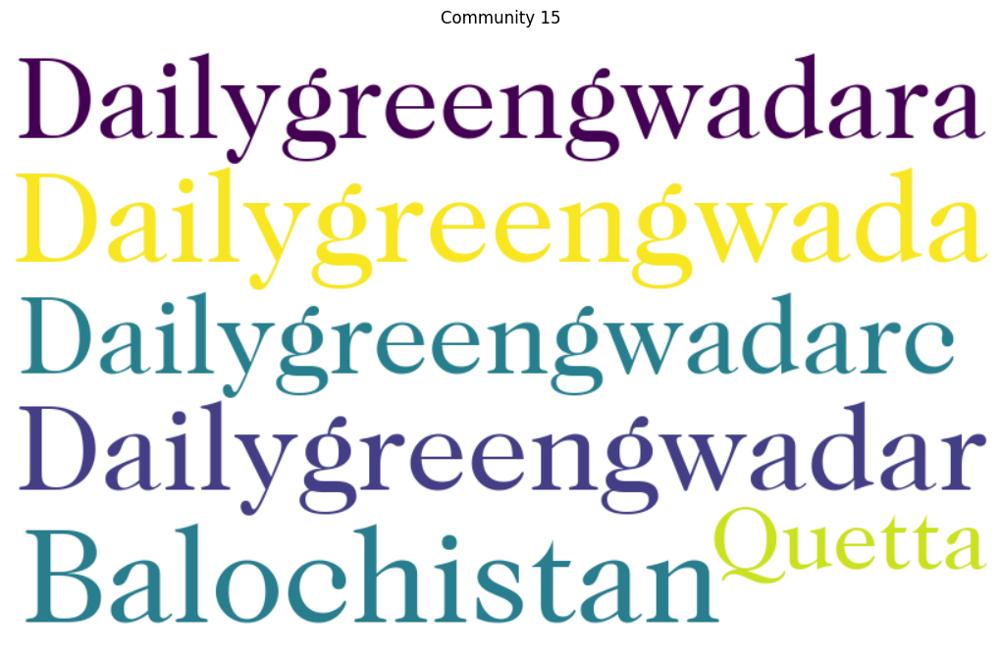

In [42]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib

matplotlib.rcParams["axes.unicode_minus"] = False
from bidi.algorithm import get_display
import arabic_reshaper

#df = df_after

# assuming `df` is your DataFrame and it has a 'community' column
for community in sorted(df_after["community"].unique()):
    subset = df_after[df_after["community"] == community]
    # print(subset.columns)
    # #freq = subset.groupby("hashtag").count() 
    # # text = get_display(arabic_reshaper.reshape(text))
    # print(subset.head())
    # if subset.empty:
    #     print(f"No hashtags for community {community}. Skipping...")
    #     continue

    freq = subset.groupby("hashtag")['user_id'].count()
    # freq = subset.groupby("hashtag")["count"].size()
    freq = freq.sort_values(ascending=False)
    freq = freq[:200]
    # print(freq)
    wordcloud = WordCloud(
        font_path="/usr/share/fonts/TTF/XB-Zar-Regular.ttf",
        width=800,
        height=500,
        random_state=21,
        max_font_size=110,
        background_color="white",
    ).generate_from_frequencies(freq)

    plt.figure(figsize=(10, 7))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Community {community}")
    # plt.show()
    save_cloud_path = os.path.join( env["plots"], "analysis", "community0_finetune", f"community_{community}_after.png")

    if not os.path.exists(os.path.dirname(save_cloud_path)):
        os.makedirs(os.path.dirname(save_cloud_path))

    # tight_layout() adjusts the subplot params so that the subplot(s) fits in to the figure area.
    plt.tight_layout()

    # remove the extra white space on the right side of the plot
    plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)
    
    #plt.show()
    plt.savefig(save_cloud_path)

In [189]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib

matplotlib.rcParams["axes.unicode_minus"] = False
from bidi.algorithm import get_display
import arabic_reshaper

# assuming `df` is your DataFrame and it has a 'community' column
for community in sorted(df["community"].unique()):
    subset = df[df["community"] == community]
    # print(subset.columns)
    # #freq = subset.groupby("hashtag").count() 
    # # text = get_display(arabic_reshaper.reshape(text))
    # print(subset.head())
    # if subset.empty:
    #     print(f"No hashtags for community {community}. Skipping...")
    #     continue

    freq = subset.groupby("hashtag")["count"].sum()
    # print top 20 hashtags and their frequencies
    print(f"Community {community}")
    #print(freq.sort_values(ascending=False).head(200).iloc[::2])
    top_200 = freq.sort_values(ascending=False).head(200)
    for hashtag, count in top_200.items():
        print(hashtag, count)    

Community 0
مولانا 16785
NewProfilePic 15267
حافظ 14735
سعدی 14478
فالو_بک 14156
آبادان 11192
واجور 10572
SaveUrmiaLake 9773
گرانی_افسارگسیخته 8879
گلگهرگیت 8419
SoundCloud 7975
گرانی 7623
MyTwitterAnniversary 6706
هوشنگ_ابتهاج 6548
متروپل_آبادان 6363
طرح_صیانت 6271
پدیده_گیت 5653
رشتو 5457
ریتوییت 5286
ريتوييت_لطفا 5213
جدی 4963
متروپل 4913
استقلال 4732
پرسپولیس 4505
حق_قانونی_استقلال 4410
اعتراضات_سراسری 4401
سید_جلال_حسینی 3930
آبادان_تسلیت 3863
وریا_تنها_نیست 3834
صائب_تبریزی 3738
نه_به_طرح_صیانت 3521
ایران 3455
حق 3400
ريتويت 3387
سایه 3353
علی_کریمی_تنها_نیست 3225
خوزستان 3196
سعدى 3188
پرسپوليس 3127
استیضاح_سجادی 3020
جمعیت_امام_علی 2955
آزمون_عدالت_نظام_وظیفه 2916
BabyDoge 2846
من_هم_شمعی_روشن_خواهم_کرد 2792
ارزشگذاری_ناعادلانه 2654
کپی 2623
فروغ_فرخزاد 2610
عباس_معروفی 2583
شهریار 2535
فکت 2483
فاضل_نظری 2469
ريتوييت 2451
آبادان_متروپل 2339
سپیده_رشنو 2332
حسین_منزوی 2310
HalaMadrid 2183
آبادان_تنها_نیست 2093
یاغی 2085
خیام 2042
گرانی_افسار_گسیخته 2013
PS752 1994
هواپیمای_اوکر

In [5]:
graph_save_path = os.path.join(env['save'], 'graph', 'hashtag_communities')

# set name of hashtags to be the hashtag itself
g.vs[user_size:]["label"] = df["hashtag"].unique()

# set label of others to ''
g.vs[:user_size]["label"] =  df['userId'].unique()

if not os.path.exists(graph_save_path):
    os.makedirs(graph_save_path)

g.save(os.path.join(graph_save_path, 'hashtag_communities_bipart_0finetune.graphml'))


In [13]:
translation_cache = {}  # Translation cache to store previously translated hashtags

# save the translation cache as json
import json

path = os.path.join(env["save"], "translation_cache.json")

translation_cache = json.load(open(path, "r"))


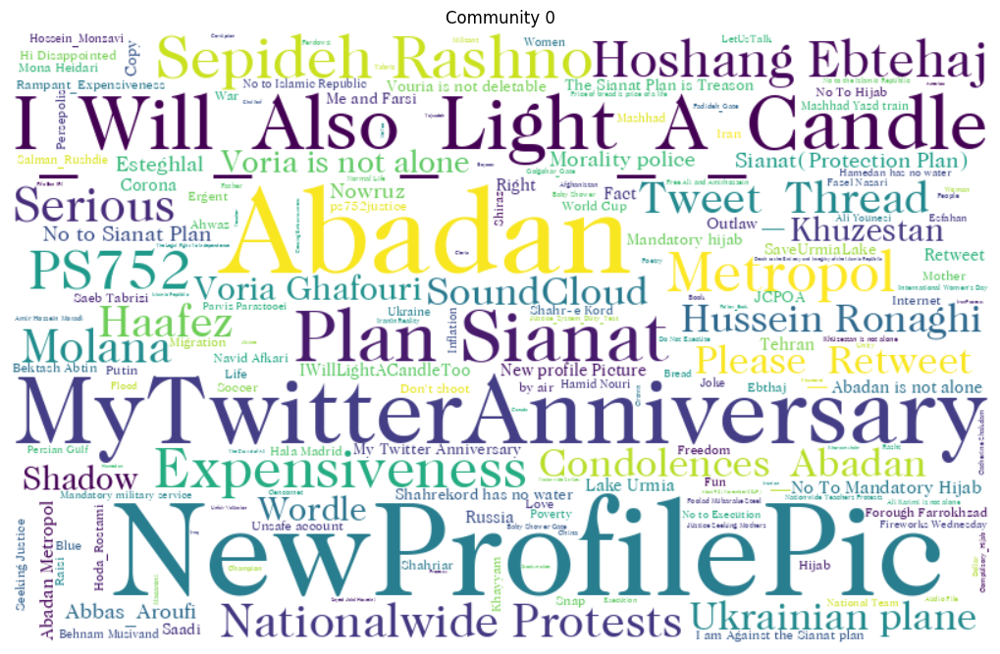

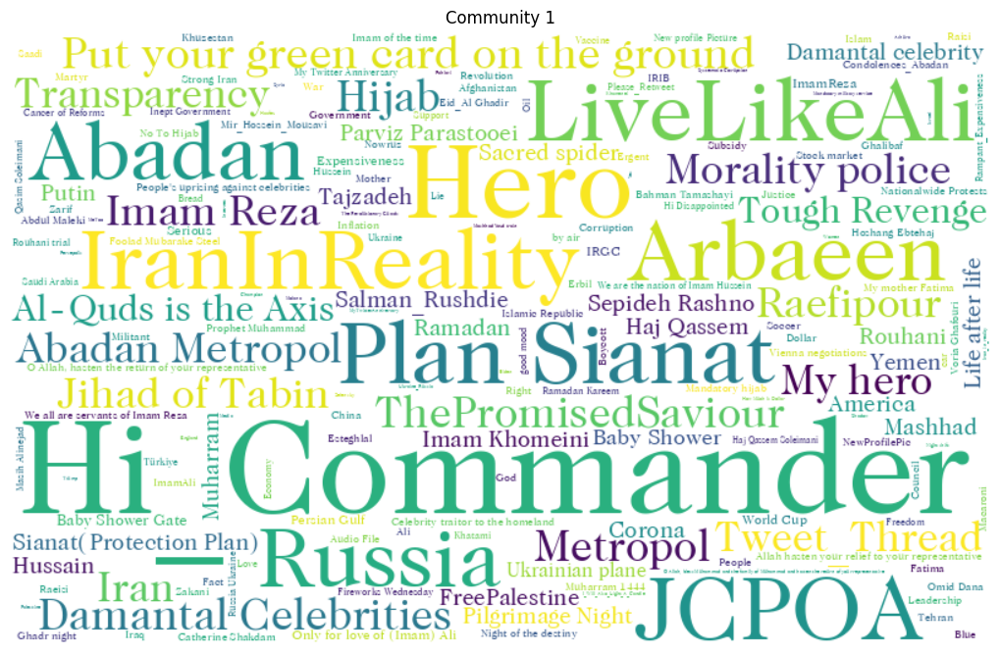

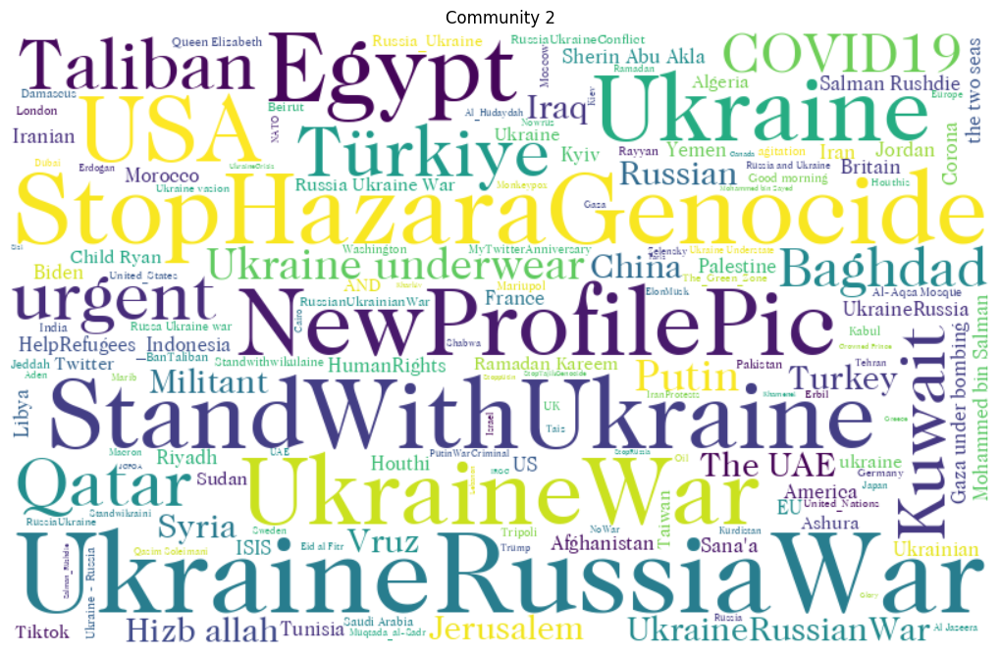

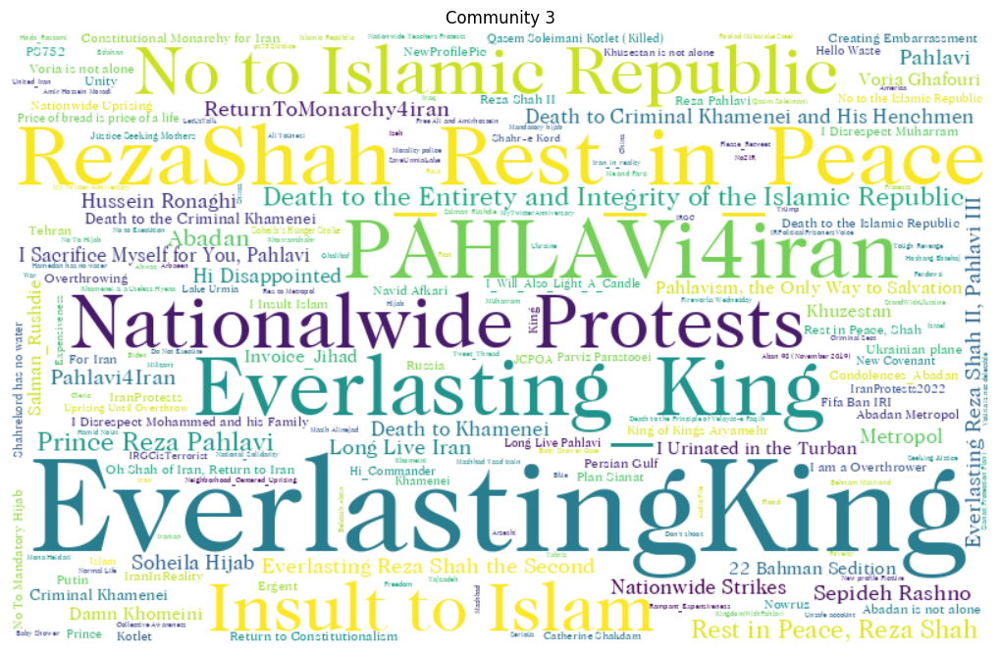

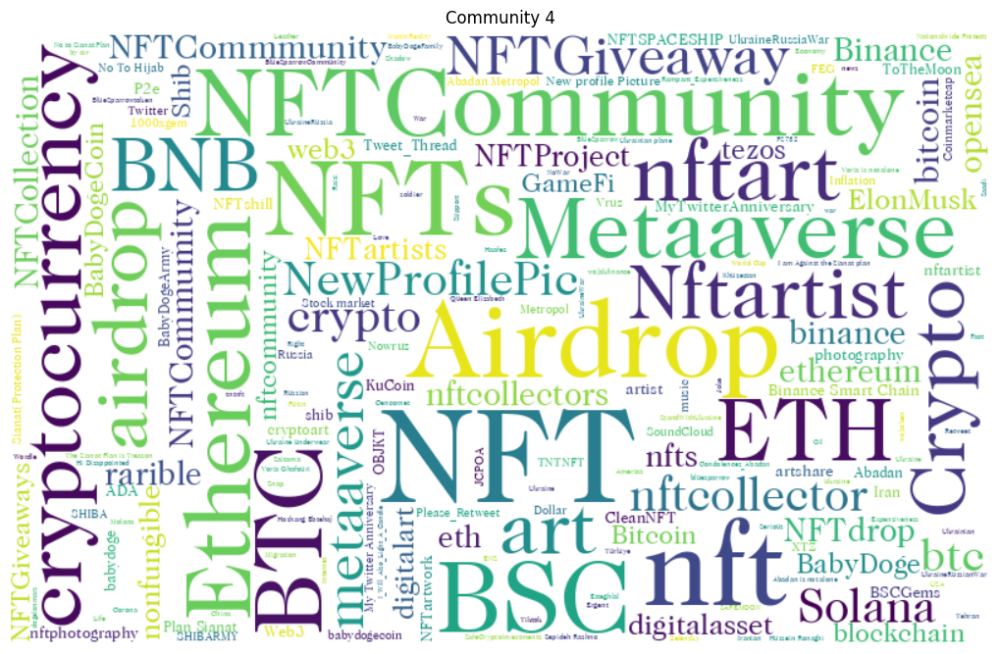

...

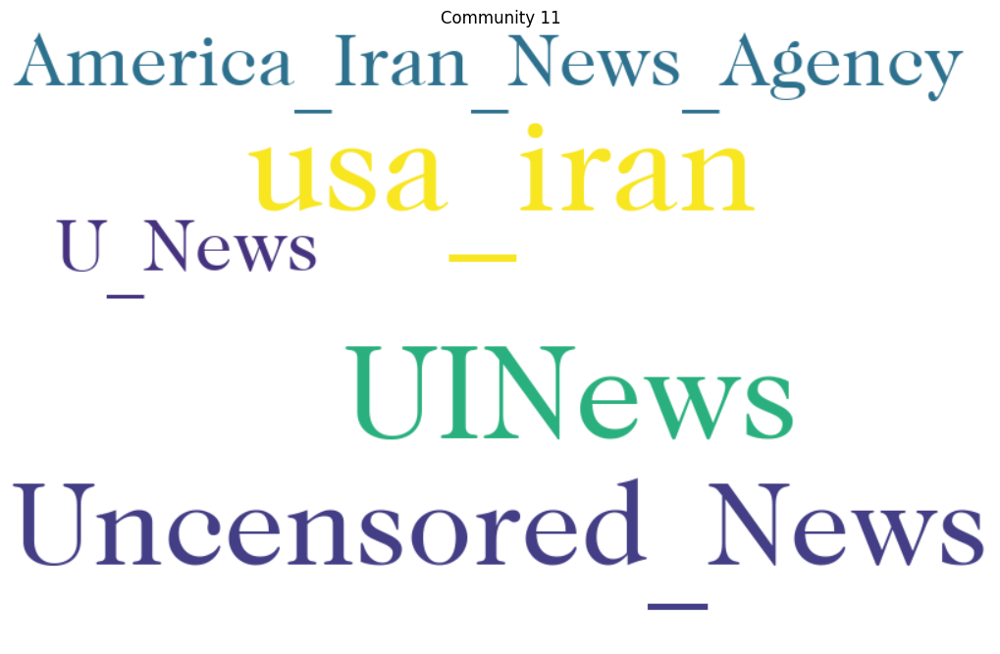

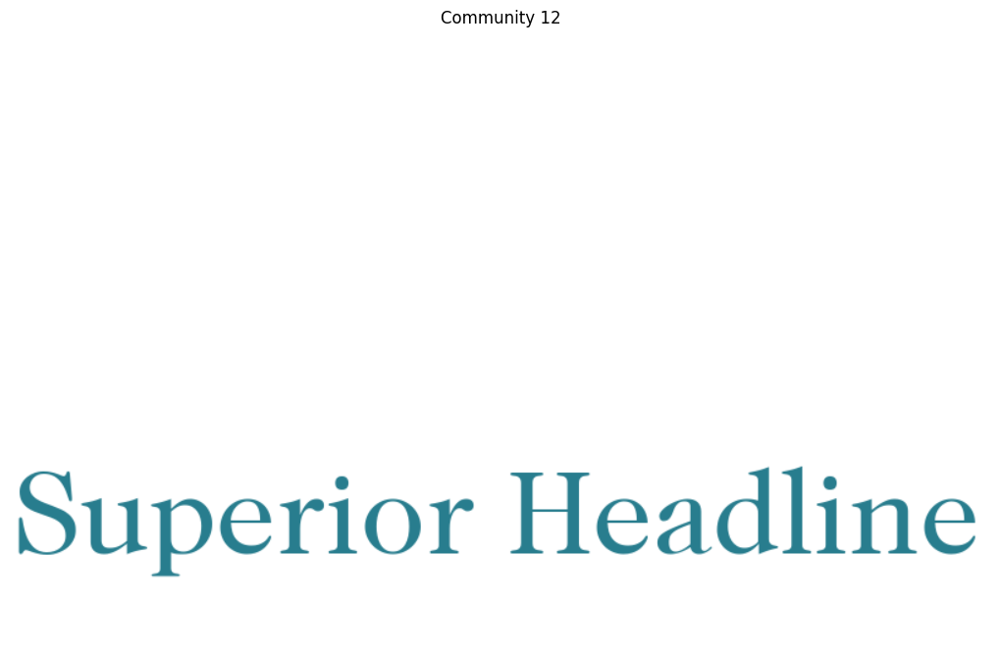

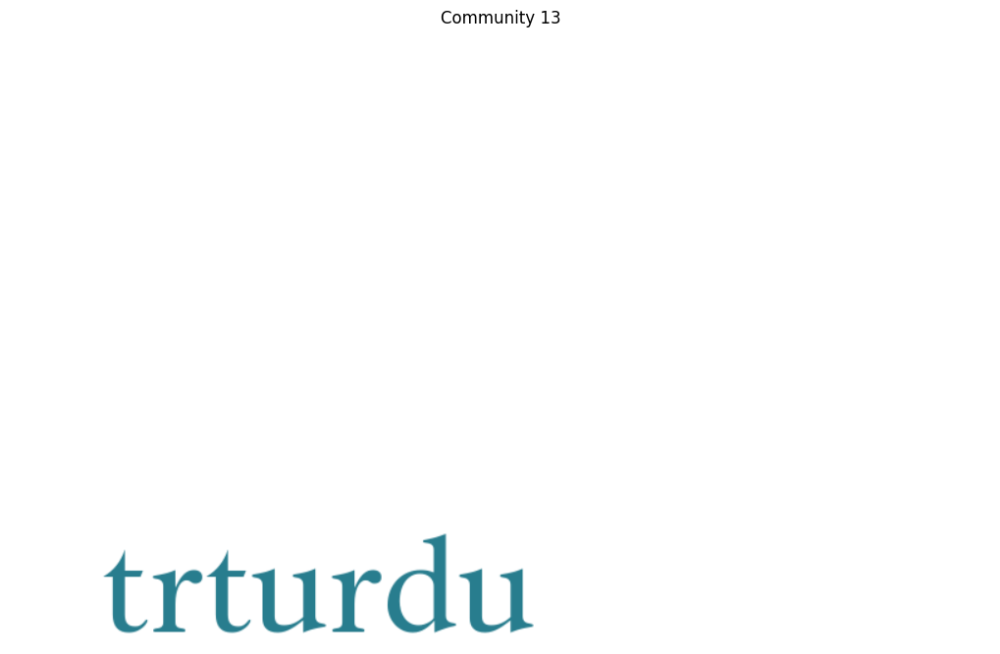

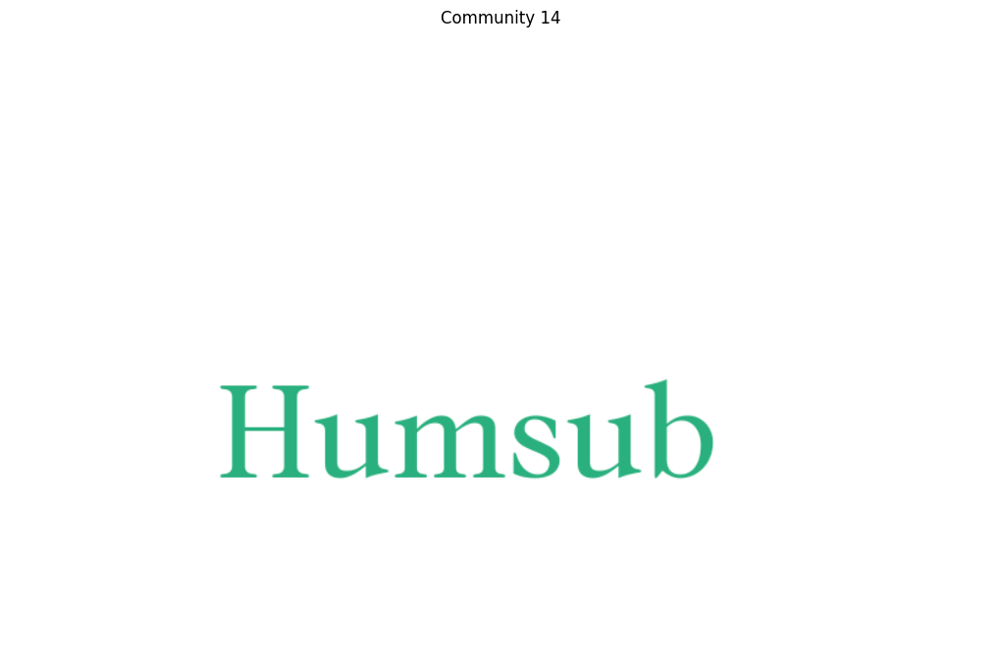

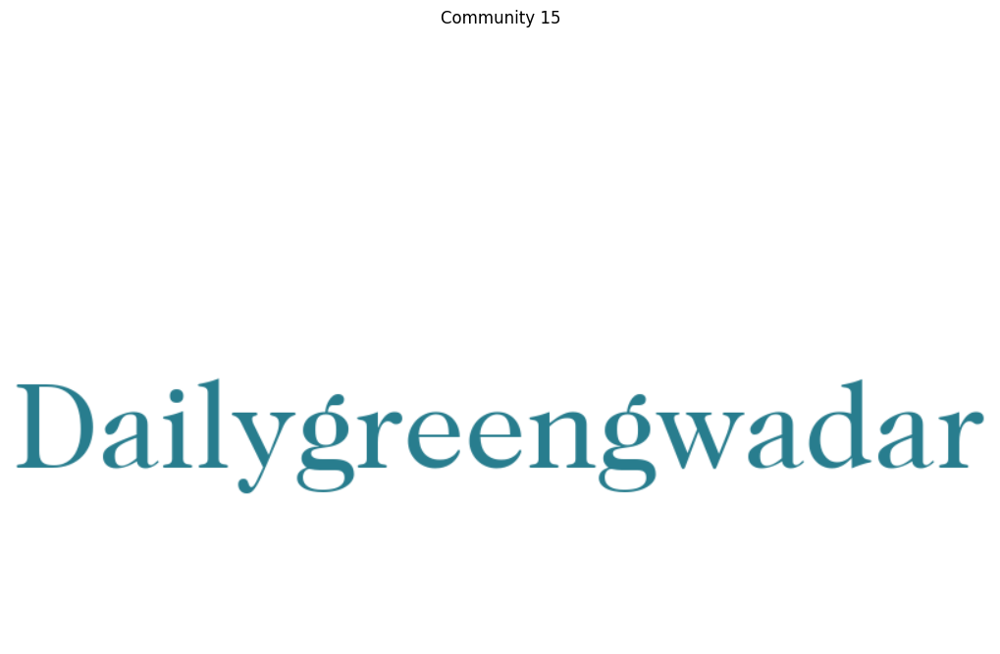

In [14]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib
from bidi.algorithm import get_display
import arabic_reshaper
from googletrans import Translator
import requests
import time
from httpx import Timeout

translator = Translator(service_urls=['translate.google.com'], timeout=Timeout(5))

matplotlib.rcParams["axes.unicode_minus"] = False

# save top 20 hashtags for each community
top_twenty = {}

# assuming `df` is your DataFrame and it has a 'community' column
for community in sorted(df["community"].unique()):
    subset = df[df["community"] == community]

    freq = subset.groupby("hashtag")['user_id'].count()
    # freq = subset.groupby("hashtag")["count"].size()
    freq = freq.sort_values(ascending=False)
    top_freq = freq[:200]



    translator = Translator(service_urls=['translate.google.com'], timeout=Timeout(5))

    # Translate the top hashtags from Arabic to English
    translated_freq = {}
    for hashtag, count in top_freq.items():
        if hashtag in translation_cache:
            translated_hashtag = translation_cache[hashtag]
        else:
            translated_hashtag = None
            while translated_hashtag is None:
                try:
                    translation = translator.translate(hashtag.replace("_", " "), dest='en', src='auto')
                    if hasattr(translation, 'text') and translation.text is not None:
                        translated_hashtag = translation.text
                        translation_cache[hashtag] = translated_hashtag
                except:
                    time.sleep(5)  # Wait for 5 seconds before retrying
                    continue

        translated_freq[translated_hashtag] = count

    # save top twenty hashtags for each community and translation 
    top_twenty[community] = translated_freq

    wordcloud = WordCloud(
        font_path="/usr/share/fonts/TTF/XB-Zar-Regular.ttf",
        width=800,
        height=500,
        random_state=21,
        max_font_size=110,
        background_color="white",
    ).generate_from_frequencies(translated_freq)

    plt.figure(figsize=(10, 7))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Community {community}")

    save_cloud_path = os.path.join(env["plots"], "analysis", "community0_finetune", f"community_{community}_en.png")

    if not os.path.exists(os.path.dirname(save_cloud_path)):
        os.makedirs(os.path.dirname(save_cloud_path))

    plt.tight_layout()
    plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)
    
    # plt.show()
    
    plt.savefig(save_cloud_path)

# save top 100 for as json



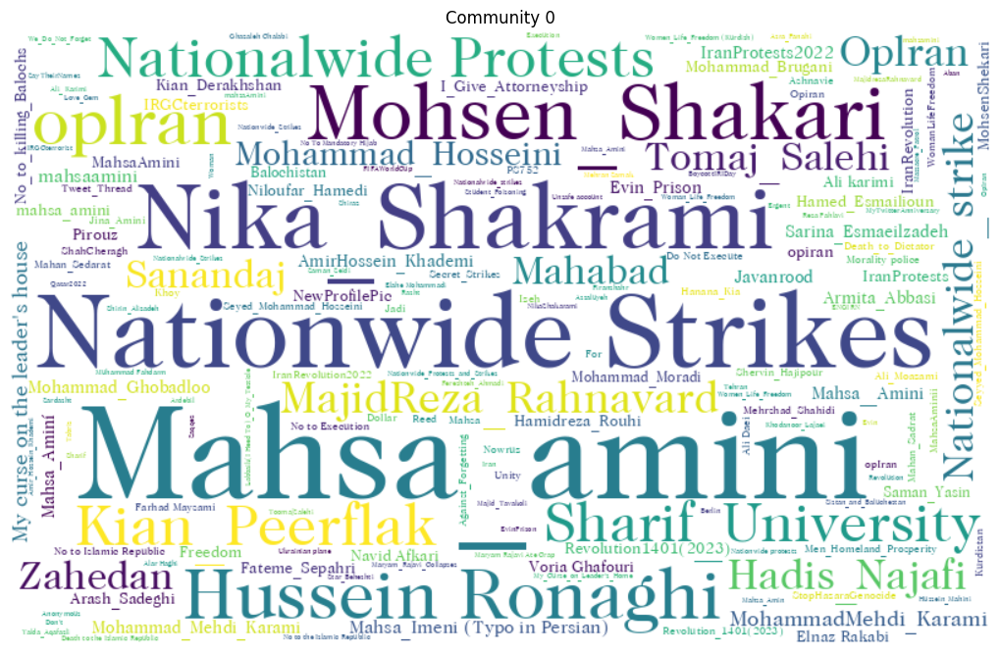

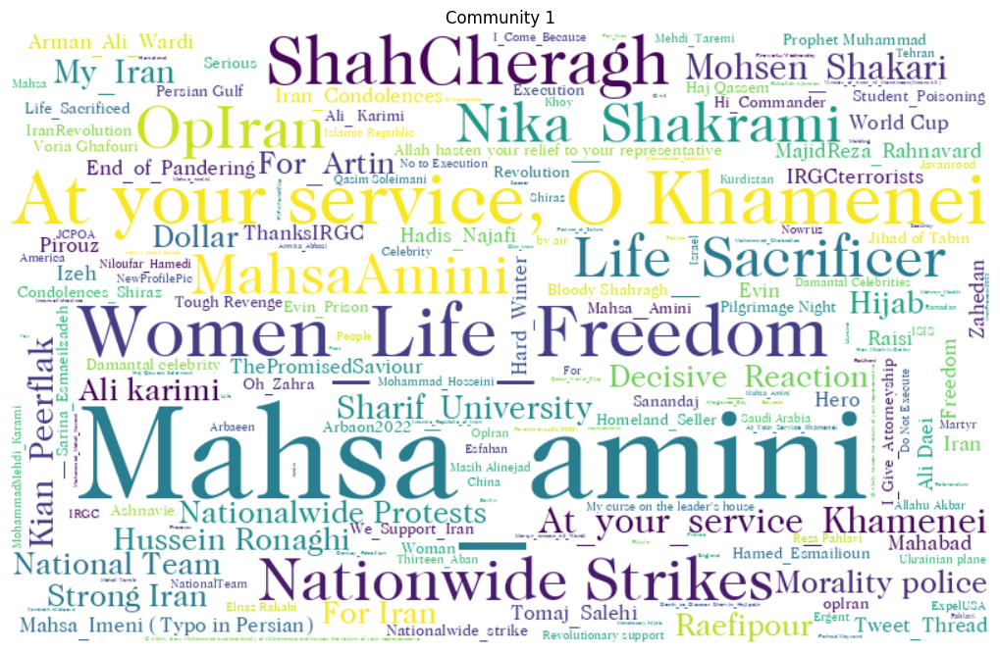

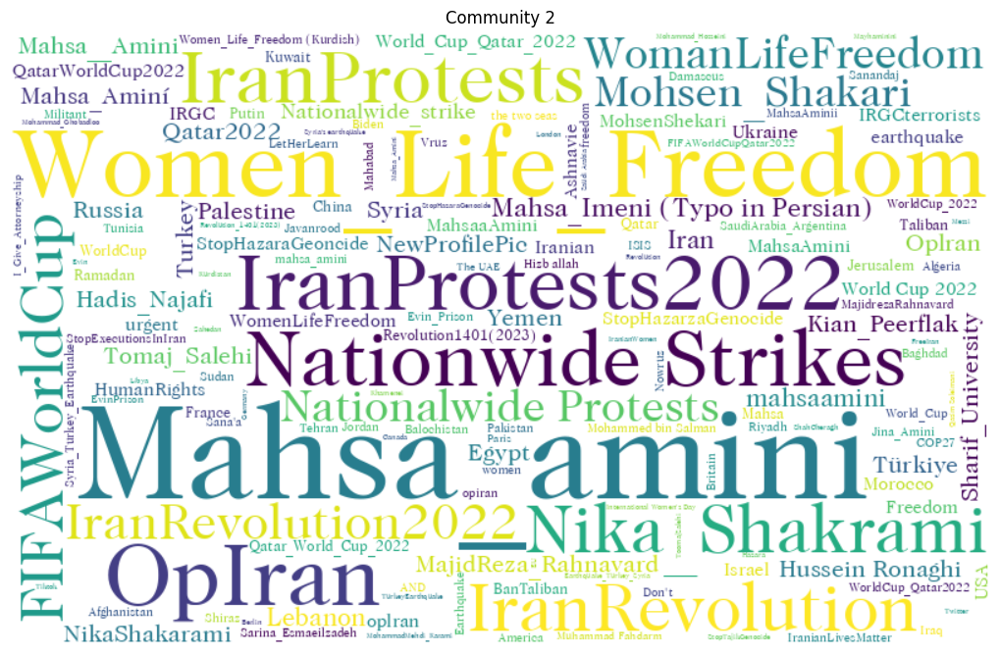

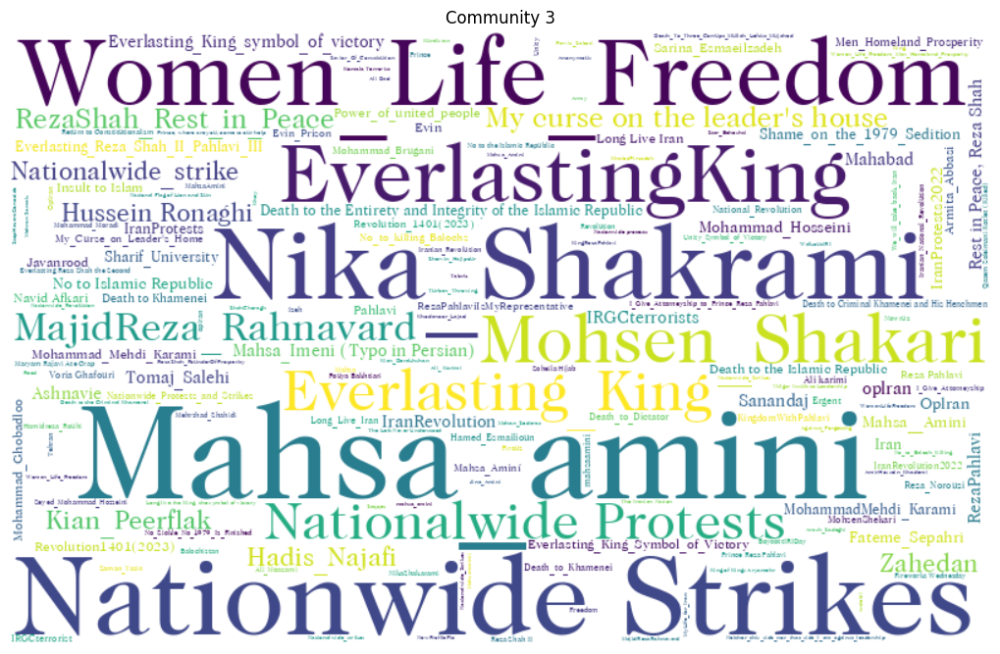

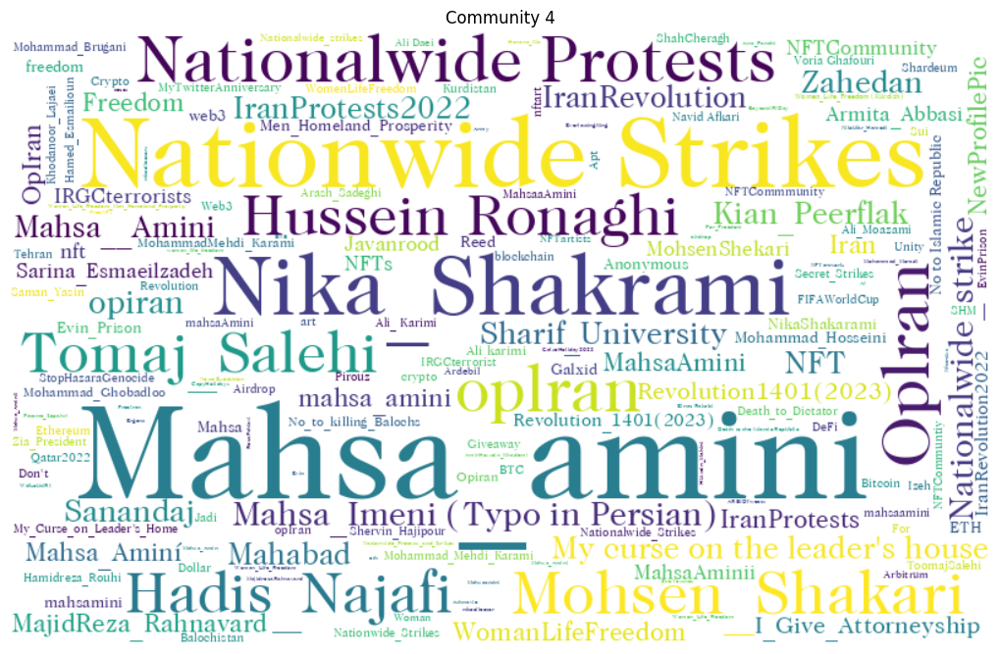

...

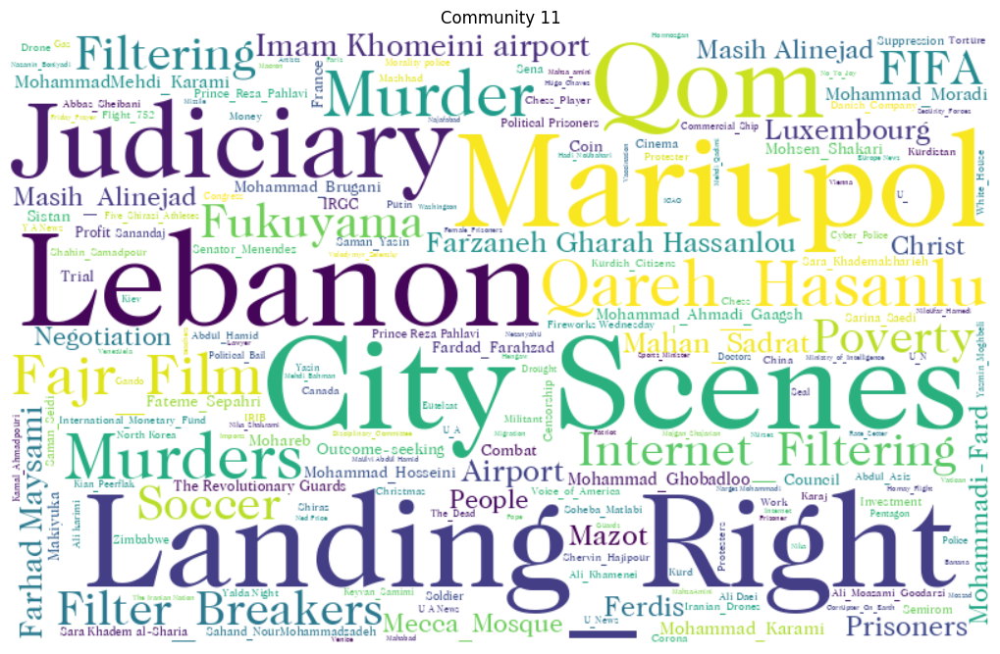

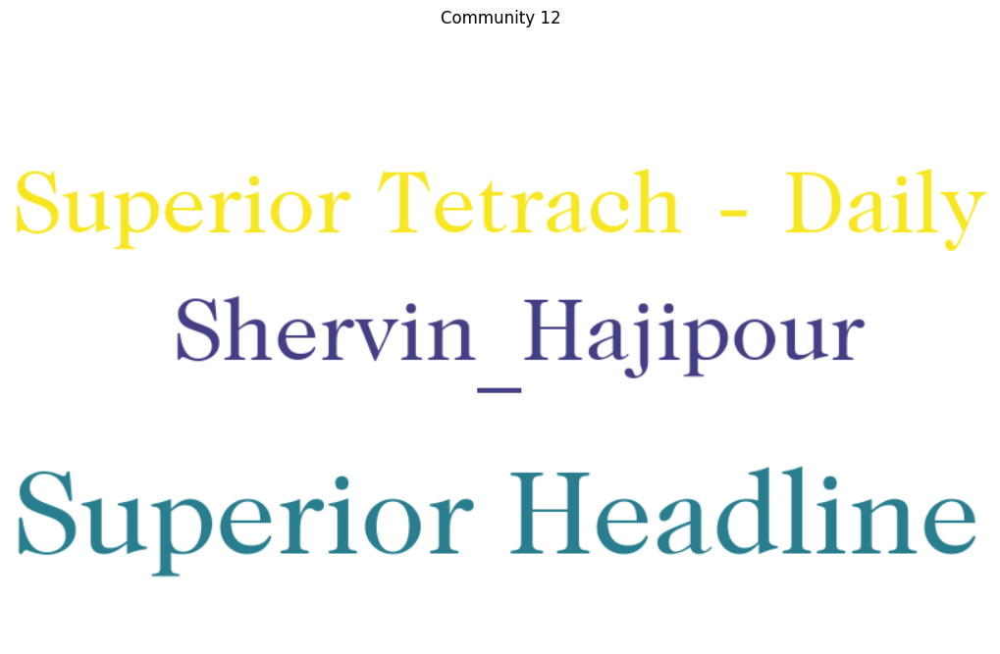

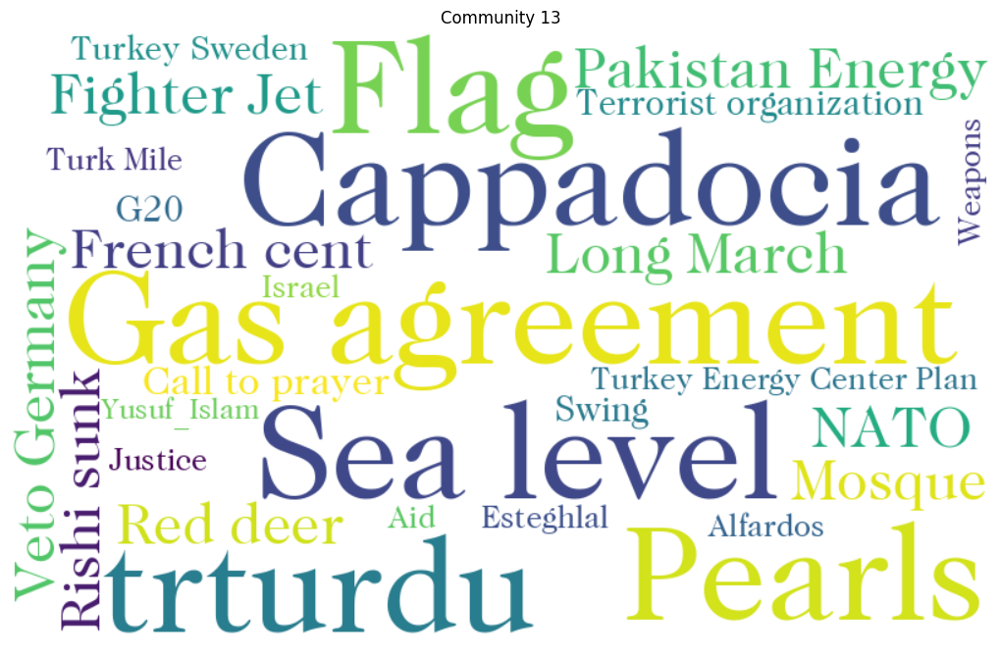

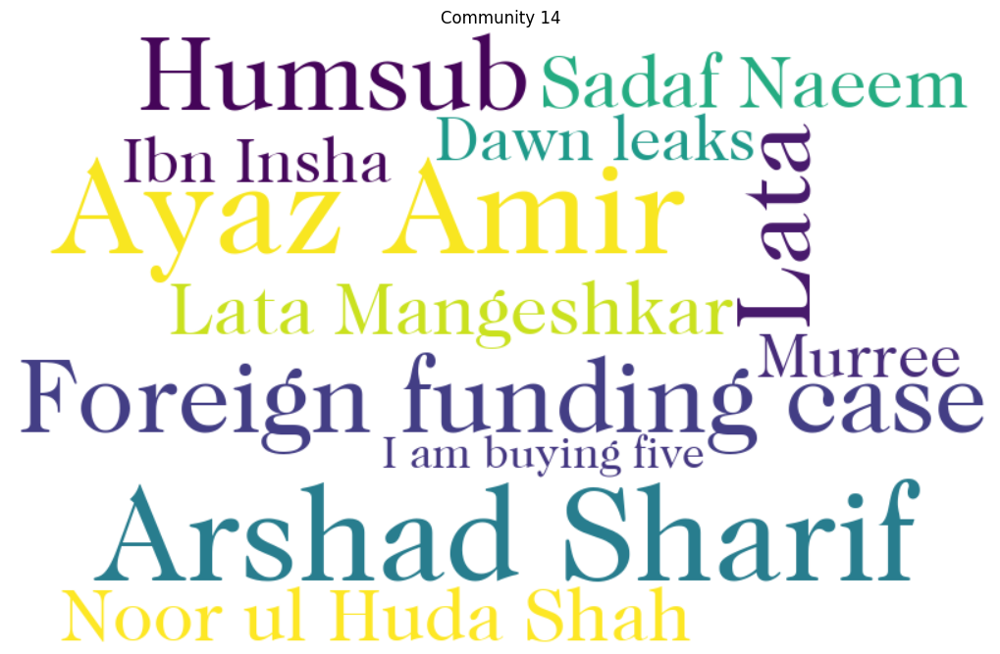

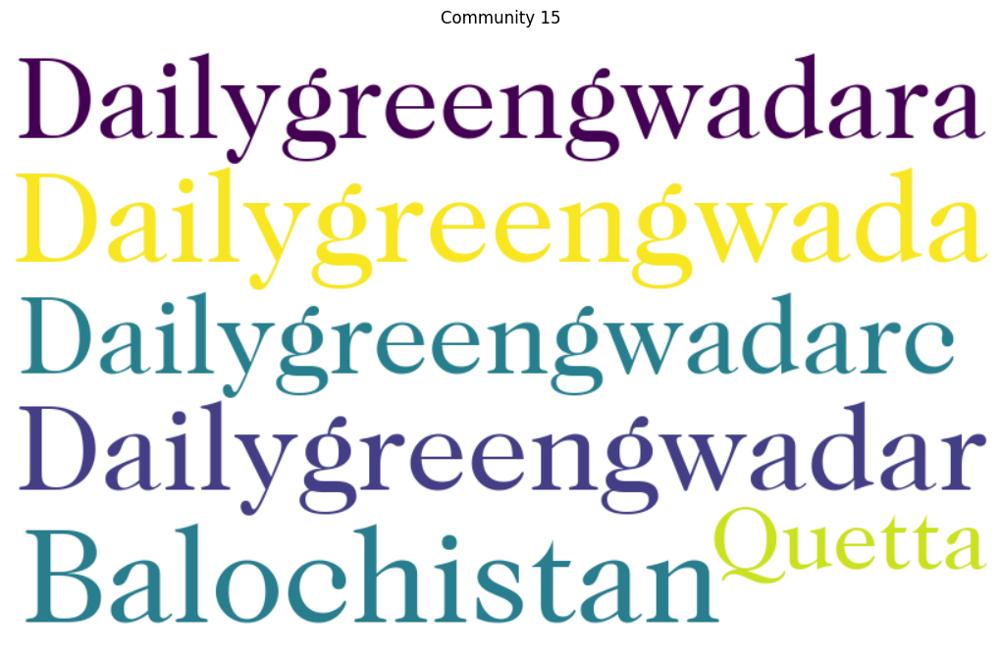

In [15]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib
from bidi.algorithm import get_display
import arabic_reshaper
from googletrans import Translator
import requests
import time
from httpx import Timeout

translator = Translator(service_urls=['translate.google.com'], timeout=Timeout(5))

matplotlib.rcParams["axes.unicode_minus"] = False

# save top 20 hashtags for each community
top_twenty = {}

# assuming `df` is your DataFrame and it has a 'community' column
for community in sorted(df_after["community"].unique()):
    subset = df_after[df_after["community"] == community]


    freq = subset.groupby("hashtag")['user_id'].count()
    # freq = subset.groupby("hashtag")["count"].size()
    freq = freq.sort_values(ascending=False)
    top_freq = freq[:200]

    
    translator = Translator(service_urls=['translate.google.com'], timeout=Timeout(5))

    # Translate the top hashtags from Arabic to English
    translated_freq = {}
    for hashtag, count in top_freq.items():
        if hashtag in translation_cache:
            translated_hashtag = translation_cache[hashtag]
        else:
            translated_hashtag = None
            while translated_hashtag is None:
                try:
                    translation = translator.translate(hashtag.replace("_"," "), dest='en', src='auto')
                    if hasattr(translation, 'text') and translation.text is not None:
                        translated_hashtag = translation.text
                        translation_cache[hashtag] = translated_hashtag
                except:
                    time.sleep(5)  # Wait for 5 seconds before retrying
                    continue

        translated_freq[translated_hashtag] = count

    # save top twenty hashtags for each community and translation 
    top_twenty[community] = translated_freq

    wordcloud = WordCloud(
        font_path="/usr/share/fonts/TTF/XB-Zar-Regular.ttf",
        width=800,
        height=500,
        random_state=21,
        max_font_size=110,
        background_color="white",
    ).generate_from_frequencies(translated_freq)

    plt.figure(figsize=(10, 7))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Community {community}")

    save_cloud_path = os.path.join(env["plots"], "analysis", "community0_finetune", f"community_{community}_en_after.png")

    if not os.path.exists(os.path.dirname(save_cloud_path)):
        os.makedirs(os.path.dirname(save_cloud_path))

    plt.tight_layout()
    plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)
    
    # plt.show()
    plt.savefig(save_cloud_path)

# save top 100 for as json



In [18]:
import json

path = os.path.join(env["save"], "analysis", "community", "top_twenty.json")

top_twenty = {}
# for each language save top 20 hashtags for each community

for community in sorted(df["community"].unique()):
    subset = df[df["community"] == community]

    freq = subset.groupby("hashtag")["count"].sum()

    # Select the top 200 hashtags based on count
    top_freq = freq.nlargest(200)
    # sort by count
    top_freq = top_freq.sort_values(ascending=False)#.head(20)

    for hashtag, count in top_freq.items():

        top_freq[hashtag] = {
            "count": count,
            "en": translation_cache[hashtag],
        }
    
    # sort by count
    
    # save top twenty hashtags for each community and translation
    top_twenty[community] = top_freq.to_dict()


if not os.path.exists(os.path.dirname(path)):
    os.makedirs(os.path.dirname(path))

with open(path, "w") as f:
    json.dump(top_twenty, f, indent=4, ensure_ascii=False)

In [9]:
translation_cache

# save the translation cache as json
import json

path = os.path.join(env["save"], "translation_cache.json")
with open(path, "w") as f:
    json.dump(translation_cache, f, ensure_ascii=False, indent=4)

# 

In [14]:
degree = g.degree()

# filter degree of hashtag nodes

user_size = len(g.vs) - len(df["hashtag"].unique())

hashtag_degree = degree[user_size:]


# print hashtag and degree
for hashtag, degree in zip(df["hashtag"].unique(), hashtag_degree):
    print(hashtag, degree)



QueenElizabeth 1425
Israel 1102
Trump 690
Afghanistan 1622
المغرب 467
افغانستان 2281
ملکه_الیزابت 1351
سوريا 827
اوكرانيا 522
بيروت 426
اليمن 1024
رمضان_مبارك 726
بايدن 1082
حماس 534
ايران 1505
أربيل 942
بريطانيا 513
عيد_الفطر 646
صنعاء 539
العراق 1359
إيران 926
فرنسا 472
GazaUnderAttack 654
انتخابات 557
تركيا 692
لبنان 1677
السعودية 1023
رمضان 2656
روسيا 889
المسجد_الأقصى 686
تايوان 593
انقلاب 1445
أمريكا 992
جدة 415
مصر 1016
دمشق 483
عمران_خان 429
شيرين_أبوعاقلة 641
الجزائر 458
الامارات 658
COVID19 865
حزب_الله 950
AppleEvent 519
سلام_يا_مهدي 608
الكويت 644
ElonMusk 1073
رونالدو 460
بيتكوين 752
سلمان_رشدي 545
قاسم_سليماني 1440
كردستان 425
crypto 779
الله 417
عمان 480
Bitcoin 1477
عاجل 709
ليبيا 470
SaudiArabia 489
France 553
RoeVsWade 420
UN 588
UkraineWar 1279
لندن 656
انفجار 506
القدس 1052
تويتر 539
Turkey 697
سريلانكا 410
طهران 593
معلم 1145
اعتراض 646
الحرب_الروسية_الاوكرانية 415
الصين 562
photography 508
InternationalWomensDay 631
كورونا 519
Yemen 1193
فلسطين 1564
كييف 527
كربلا

In [197]:

degree = g.degree()
print("Degree Centrality: ", degree)

# Betweenness centrality
betweenness = g.betweenness()
print("Betweenness Centrality: ", betweenness)

# Eigenvector centrality
eigenvector = g.eigenvector_centrality()
print("Eigenvector Centrality: ", eigenvector)

Degree Centrality:  [54, 65, 101, 96, 85, 72, 30, 89, 106, 91, 51, 20, 116, 81, 55, 108, 55, 86, 81, 46, 81, 103, 28, 89, 105, 92, 89, 198, 119, 19, 67, 96, 88, 68, 87, 34, 37, 46, 34, 112, 125, 93, 30, 72, 131, 20, 86, 105, 116, 9, 15, 76, 36, 71, 84, 71, 70, 97, 47, 29, 113, 84, 123, 13, 23, 111, 142, 41, 99, 121, 37, 32, 168, 12, 97, 51, 34, 85, 61, 16, 83, 484, 63, 59, 142, 348, 65, 40, 80, 49, 16, 22, 134, 69, 21, 60, 47, 294, 36, 71, 21, 72, 34, 45, 26, 72, 128, 60, 153, 29, 83, 16, 47, 104, 35, 58, 56, 74, 38, 56, 48, 84, 206, 490, 123, 72, 40, 4, 18, 85, 29, 47, 103, 107, 34, 90, 28, 20, 53, 16, 55, 23, 17, 32, 69, 94, 49, 129, 61, 15, 29, 144, 62, 68, 17, 35, 89, 42, 172, 103, 140, 23, 90, 26, 31, 48, 17, 120, 17, 117, 30, 64, 107, 152, 78, 18, 27, 39, 47, 91, 35, 260, 81, 58, 76, 346, 48, 7, 6, 89, 80, 45, 76, 4, 89, 28, 37, 55, 40, 90, 76, 76, 17, 80, 122, 267, 134, 131, 86, 76, 58, 74, 33, 41, 45, 32, 371, 262, 75, 120, 14, 24, 46, 30, 3, 91, 153, 25, 31, 139, 15, 433, 70, 

KeyboardInterrupt: 

In [33]:
sample_size = 4500

# 2. Sample nodes
# Group nodes by community
groups = df.groupby('community')

# Sample from each group
sampled_nodes = groups.apply(lambda x: x.sample(n=int((x['userId'].nunique()/df['userId'].nunique())*sample_size)))

# Get the unique sampled userIds
sampled_ids = sampled_nodes['userId'].unique()

# 3. Create a subgraph
# Get the vertex indices corresponding to the sampled user Ids
vertex_indices = [g.vs.find(name=str(i)).index for i in sampled_ids if str(i) in g.vs['name']]

# Create a subgraph
subgraph = g.subgraph(vertex_indices)

# Plot the subgraph


In [34]:
import networkx as nx
from pyvis.network import Network


# Convert igraph to networkx
G_nx = ig.Graph.to_networkx(subgraph)

# Create a pyvis network
G_pyvis = Network(notebook=True)
G_pyvis.from_nx(G_nx)

# Show the network
G_pyvis.show("graph.html")

graph.html


In [280]:
# # group the data by community and hashtag and count the number of unique users for each combination
# community_hashtag_users = df.groupby(['community', 'hashtag'])['user_id'].nunique().reset_index(name='unique_users')

# # calculate the total number of unique users in each community
# community_users = df.groupby('community')['user_id'].nunique()

# # calculate the total number of unique users for each hashtag
# hashtag_users = df.groupby('hashtag')['user_id'].nunique()

# # calculate the proportion of unique hashtag users in each community
# community_hashtag_users['proportion_in_community'] = community_hashtag_users.apply(lambda row: row['unique_users'] / community_users[row['community']], axis=1)

# # calculate the proportion of unique hashtag users in other communities
# community_hashtag_users['proportion_in_other_communities'] = community_hashtag_users.apply(lambda row: (hashtag_users[row['hashtag']] - row['unique_users']) / hashtag_users[row['hashtag']], axis=1)

# # select the top hashtags in each community based on unique users
# top_hashtags = community_hashtag_users.groupby('community').apply(lambda group: group.nlargest(2000, 'unique_users'))
# group the data by community and hashtag and sum the total count for each combination
community_hashtag_counts = df.groupby(['community', 'hashtag'])['count'].sum().reset_index(name='total_count')

# calculate the total count in each community
community_counts = df.groupby('community')['count'].sum()

# calculate the total count for each hashtag
hashtag_counts = df.groupby('hashtag')['count'].sum()

# calculate the proportion of hashtag usage in each community
community_hashtag_counts['proportion_in_community'] = community_hashtag_counts.apply(lambda row: row['total_count'] / community_counts[row['community']], axis=1)

# Define the important communities
important_communities = [0, 1, 2, 6]

# calculate the proportion of hashtag usage in each important community
for community in important_communities:
    community_hashtag_counts[f'proportion_in_community_{community}'] = community_hashtag_counts.apply(
        lambda row: row['total_count'] / community_counts[community] if community != row['community'] else 0, axis=1)

# calculate the maximum proportion of hashtag usage in other important communities
community_hashtag_counts['max_proportion_in_other_important_communities'] = community_hashtag_counts[
    [f'proportion_in_community_{community}' for community in important_communities]].max(axis=1)

# Now we can select the top hashtags in each community based on total count
top_hashtags = community_hashtag_counts.groupby('community').apply(lambda group: group.nlargest(2000, 'total_count'))


In [282]:
exclusive_hashtags = top_hashtags[(top_hashtags['proportion_in_community'] > 0.0003) & (top_hashtags['max_proportion_in_other_important_communities'] < 0.0003)]

exclusive_hashtags[exclusive_hashtags['community'] == 1].head(1000)['hashtag'].values

array([], dtype=object)

In [241]:


exclusive_hashtags[exclusive_hashtags['community'] == 6].head(1000)['hashtag'].values

array(['DontFreeTerrorists', 'IranProtests', 'مجاهدین_خلق',
       'میتوان_و_باید', 'رئیسی_جلاد۶۷', 'No2Appeasement',
       'کانونهای_شورشی', 'WeCanAndMust', 'مسعود_رجوی', 'قيام_تا_سرنگونی',
       'اوکراین', 'مریم_رجوی', 'قتل_عام۶۷', 'ProsecuteRaisiNow',
       'سرنگونی', 'FreeIranTelethon', 'دیپلمات_تروریست',
       'آری_به_جمهوری_دمکراتیک', 'ProsecuteRaisiNOW', 'WeStand4FreeIran',
       'قيام_تا_سرنگونى', 'دادخواهی', 'همیاری', 'إيران', '1988Massacre',
       'حمید_نوری', 'تهران', 'مريم_رجوی', 'خامنه\u200cای_جنایتکار',
       'VictimsOfTerrorism', 'مرگ_بر_خامنه\u200cای', 'براندازم',
       'IWD2022', 'انحلال_سپاه_پاسداران', 'روز_حساب_نزدیکه',
       'نه_به_اعدام', 'درود_بر_مجاهد', 'HumanRights', 'رمضان',
       'WeSupportMEK', 'اعتراضات_سراسری_معلمان', 'زنان_نیروی_تغییر',
       'Westand4FreeIran', 'StopExecutionsInIran', 'مجاهدین',
       'قیام_سراسری', 'مريم_رجوي', 'Ramadan', 'FreeIran', 'بازنشستگان',
       'MEKResistanceUnits', 'روز_جهانی_زن', 'خوزستان',
       'مرگ_بر_خامنه\u2

In [260]:
import matplotlib.pyplot as plt
import numpy as np

# Define the number of top hashtags to show for each community
top_n = 100

# Define the communities to include
communities = [ 1, 3, 6]

# Define a threshold for what constitutes a "high" proportion in other communities
threshold = 0.001  # 1%, but you can adjust this as needed
community_ownership_threshold = 0.01

all_bridge_hashtags = set()

# Iterate over each community
for i, community in enumerate(communities):
    # Filter the data for the current community
    community_data = df[df['community'] == community]

    # Group the data by hashtag and calculate the number of unique users for each hashtag
    hashtag_user_counts = community_data.groupby('hashtag')['user_id'].nunique()

    # Get the top N hashtags for the current community
    top_hashtags = hashtag_user_counts.nlargest(top_n)

    # Get the unique hashtags and their indices
    hashtags = top_hashtags.index.tolist()
    indices = np.arange(len(hashtags))

    # Initialize arrays for storing the proportions of hashtag usage in all communities
    proportion_data_all = np.zeros((len(hashtags), len(communities)))

    # Initialize list to store the bridge hashtags
    bridge_hashtags = []

    # Calculate the proportions of unique users for each hashtag in all communities
    for j, other_community in enumerate(communities):


        other_community_data = df[df['community'] == other_community]
        other_hashtag_user_counts = other_community_data.groupby('hashtag')['user_id'].nunique()


        for k, hashtag in enumerate(hashtags):
            proportion_other = other_hashtag_user_counts.get(hashtag, 0) / other_hashtag_user_counts.sum()
            proportion_data_all[k, j] = proportion_other
            portion_in_this_communjity = hashtag_user_counts.get(hashtag, 0) / hashtag_user_counts.sum()
            # Check if the hashtag has a high proportion in other communities
            if community != other_community and proportion_other > threshold and portion_in_this_communjity > community_ownership_threshold:
                bridge_hashtags.append(hashtag)

    # Print the bridge hashtags
    print(f"Community {community} bridge hashtags: {bridge_hashtags}")

    all_bridge_hashtags.update(bridge_hashtags)

# Print total bridge hashtags
print(f"Total bridge hashtags: {all_bridge_hashtags}")


Community 1 bridge hashtags: ['FreePalestine', 'القدس_هي_المحور', 'IranInReality']
Community 3 bridge hashtags: ['Iran']
Community 6 bridge hashtags: []
Total bridge hashtags: {'FreePalestine', 'Iran', 'IranInReality', 'القدس_هي_المحور'}


In [250]:
# Define exclusive propaganda communities
exclusive_propaganda_communities = [1, 3, 6]

# Assign label for exclusive propaganda
exclusive_hashtags['exclusive_propaganda'] = exclusive_hashtags['community'].apply(lambda x: 1 if x in exclusive_propaganda_communities else 0)


hashtags_path = os.path.join(env['save'], 'hashtags', 'top_hashtag_before.csv')

# Load your csv file
df_csv = pd.read_csv(hashtags_path)

# Merge the two dataframes with an 'outer' join to include all hashtags
merged_df = pd.merge(df_csv, exclusive_hashtags, on='hashtag', how='outer')

# Replace NaN values with default values in the necessary columns
merged_df['exclusive_propaganda'].fillna(0, inplace=True)
merged_df['count'].fillna(0, inplace=True)
merged_df['weight'].fillna(1, inplace=True)


# Change the weight for exclusive propaganda hashtags
merged_df['weight'] = merged_df.apply(lambda row: 20 if row['exclusive_propaganda'] == 1 else row['weight'], axis=1)


# Convert the all_bridge_hashtags set to a DataFrame
bridge_hashtags_df = pd.DataFrame(list(all_bridge_hashtags), columns=['hashtag'])

# Add an 'is_bridge_hashtag' column
bridge_hashtags_df['is_bridge_hashtag'] = 1

# Merge the bridge hashtags DataFrame with the merged DataFrame
merged_df = pd.merge(merged_df, bridge_hashtags_df, on='hashtag', how='left')

# Replace NaN values with 0 in the 'is_bridge_hashtag' column
merged_df['is_bridge_hashtag'].fillna(0, inplace=True)

# Set weight to 0 for bridge hashtags
merged_df['weight'] = merged_df.apply(lambda row: 1 if row['is_bridge_hashtag'] == 1 else row['weight'], axis=1)

optimized_weight_path = os.path.join(env['save'], 'hashtags', 'optimized_weight.csv')

# Save the optimized weight DataFrame as a csv file
merged_df.to_csv(optimized_weight_path, index=False)

Filtering DataFrame...
Number of unique users: 100374
Number of unique hashtags: 1451
Creating graph...
Added vertices...
Computing edges...
Adding edges...
Number of vertices:  101825
Number of edges:  1055962
Finding communities...
Number of communities:  14


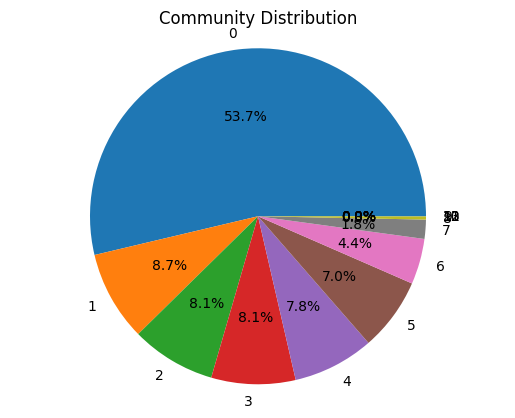

In [251]:
import os, yerbamate, ipdb
import pandas as pd
import igraph as ig
import leidenalg as la
import matplotlib.pyplot as plt

env = yerbamate.Environment()

path = os.path.join(env["plots"], "analysis", "user_hashtag_before.parquet")

df = pd.read_parquet(path)

df_after = pd.read_parquet(os.path.join(env['plots'], 'analysis', 'user_hashtag_after.parquet'))


hashtags_path = os.path.join(env['save'], 'hashtags', 'optimized_weight.csv')

print("Filtering DataFrame...")

# hashtag_counts = df.groupby("hashtag").size().reset_index(name="counts")
top_hashtags = pd.read_csv(hashtags_path)

# drop weight 0 hashtags
top_hashtags = top_hashtags[top_hashtags["weight"] > 0]


# create a set of the top hashtags for faster lookup
top_hashtags_set = set(top_hashtags["hashtag"])

# filter the original DataFrame
df_filtered = df[df["hashtag"].isin(top_hashtags_set)]

df = df_filtered

# prrint number of unique users and hashtags
print(f"Number of unique users: {len(df['userId'].unique())}")
print(f"Number of unique hashtags: {len(df['hashtag'].unique())}")

print("Creating graph...")
# initialize a new graph
g = ig.Graph(directed=False)
# g.add_vertex(n=len(df["userId"].unique()), type="user")
# g.add_vertex(n=len(df["hashtag"].unique()), type="hashtag")
user_size = len(df["userId"].unique())


g.add_vertices(n=len(df["userId"].unique()) + len(df["hashtag"].unique()))

# set name of hashtags to be the hashtag itself
g.vs[user_size:]["name"] = df["hashtag"].unique()

# Add types for vertices
g.vs["type"] = [True if i < user_size else False for i in range(g.vcount())]


print("Added vertices...")
# map users and hashtags to unique integers
user_mapping = {user: i for i, user in enumerate(df["userId"].unique())}
hashtag_mapping = {
    hashtag: i + len(user_mapping) for i, hashtag in enumerate(df["hashtag"].unique())
}

print("Computing edges...")
 

df["user_id"] = df["userId"].map(user_mapping)
df["hashtag_id"] = df["hashtag"].map(hashtag_mapping)
top_hashtags["hashtag_id"] = top_hashtags["hashtag"].map(hashtag_mapping)

#df['weight'] = df['hashtag_id'].map(lambda x: top_hashtags[top_hashtags['hashtag_id'] == x]['weight'].values[0])

# create the list of edges
edges = list(zip(df["user_id"], df["hashtag_id"]))

# weight is the weight in top_hashtags dataframe, where as if the edge ends with hashtag_id, the weight is the top_hashtags['hashtag'] weight
#weights = [top_hashtags[top_hashtags['hashtag_id'] == x[1]]['weight'].values[0] for x in edges]
# edges.map(lambda x: top_hashtags[top_hashtags['hashtag_id'] == x[1]]['weight'])
hashtag_id_to_weight = top_hashtags.set_index('hashtag_id')['weight'].to_dict()
weights = [hashtag_id_to_weight[x[1]] for x in edges]

print("Adding edges...")

g.add_edges(edges)

# weights = df["count"].values

# normalize the weights
# weights = weights / weights.max()

g.es["weight"] = weights


# # add the edges with weights
# g.es["weight"] = weightsu

# # add the edges with weights
# g.es['weight'] = weights
print("Number of vertices: ", len(g.vs))
print("Number of edges: ", len(g.es))

print("Finding communities...")


# get the partition using the Leiden algorithm
import leidenalg as la

partition = la.find_partition(g, la.ModularityVertexPartition, weights= weights, n_iterations=10)#g.es["weight"])

print("Number of communities: ", len(partition))

# add the partition to the graph
g.vs["partition"] = partition.membership

df['community'] =  df['user_id'].map( lambda x: g.vs[x]['partition'])


# df after has differet size, we only want to keep people that are in the graph
df_after = df_after[df_after['userId'].isin(df['userId'].unique())]

df_after["user_id"] = df_after["userId"].map(user_mapping)
# df_after["hashtag_id"] = df_after["hashtag"].map(hashtag_mapping)

df_after['community'] = df_after['user_id'].map( lambda x: g.vs[x]['partition'])

# Get the community sizes
community_sizes = partition.sizes()

# Plot the pie chart
plt.pie(community_sizes, labels=range(len(community_sizes)), autopct='%1.1f%%')
plt.title('Community Distribution')
plt.axis('equal')

# Show the chart
plt.show()

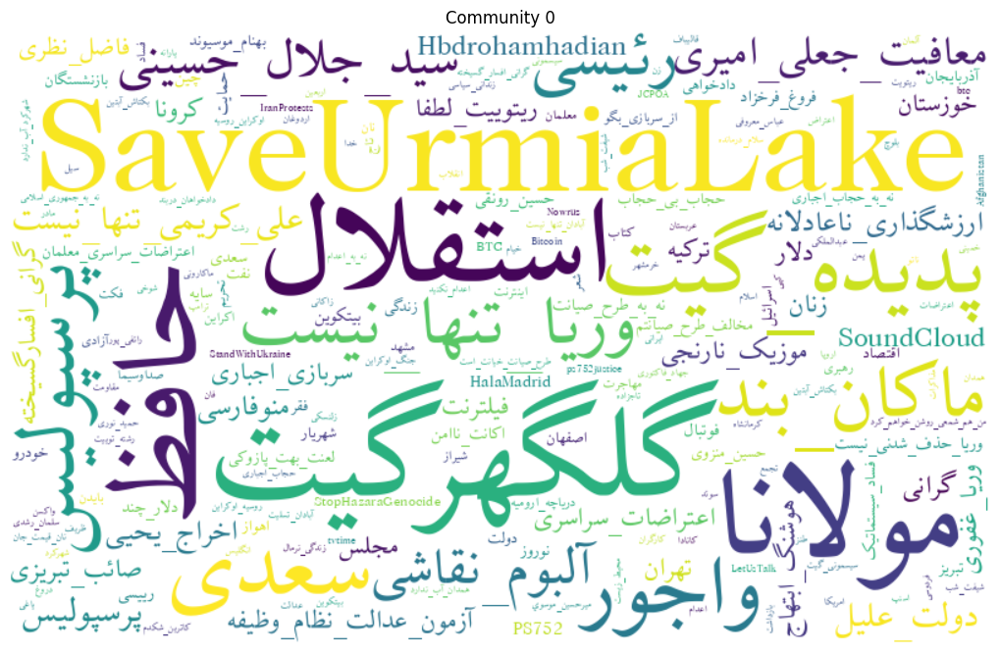

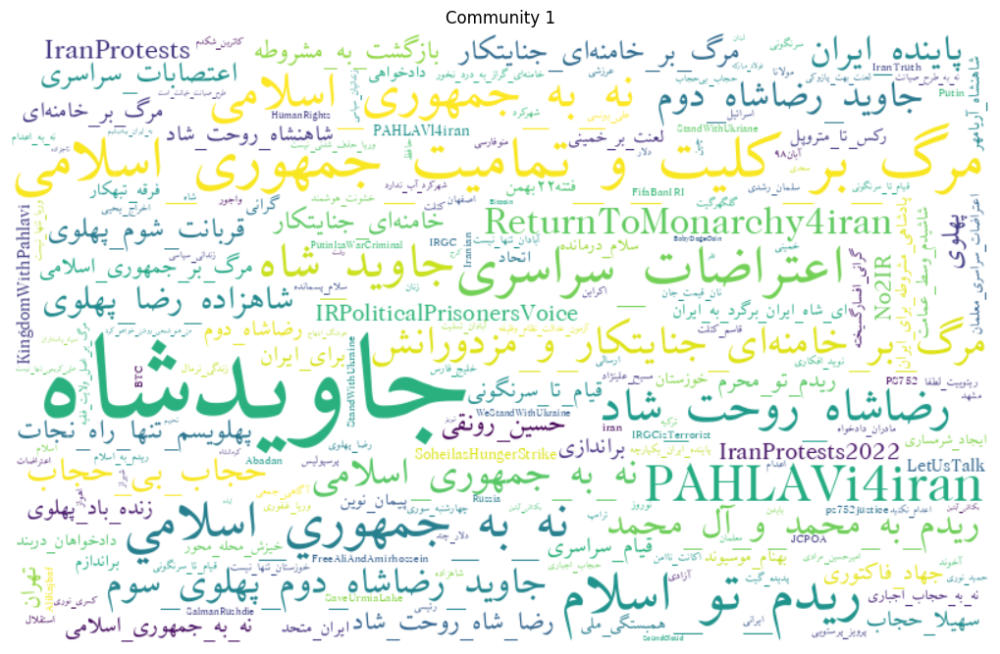

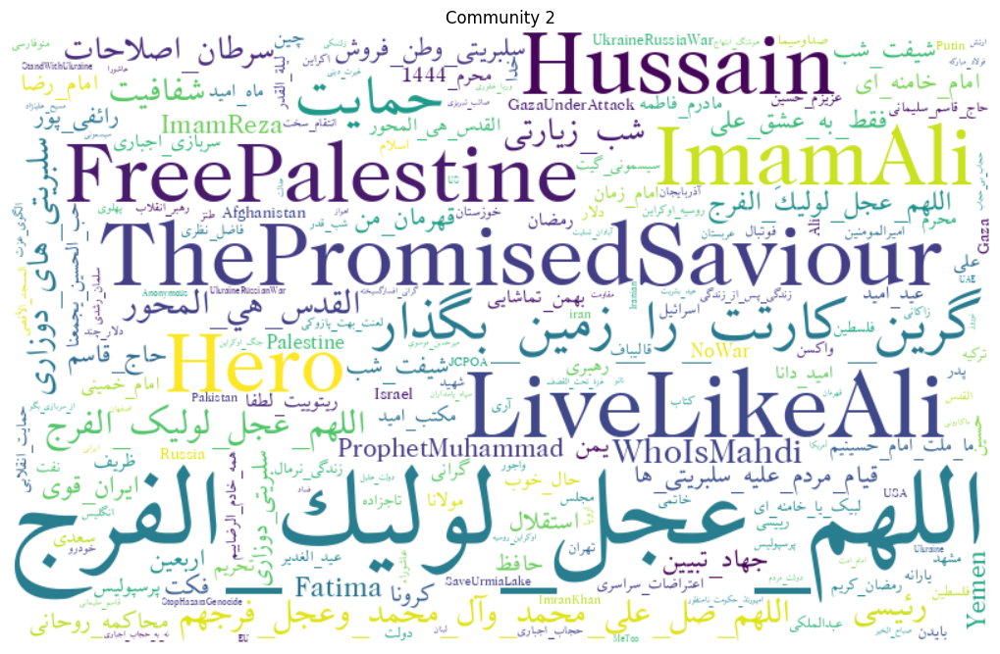

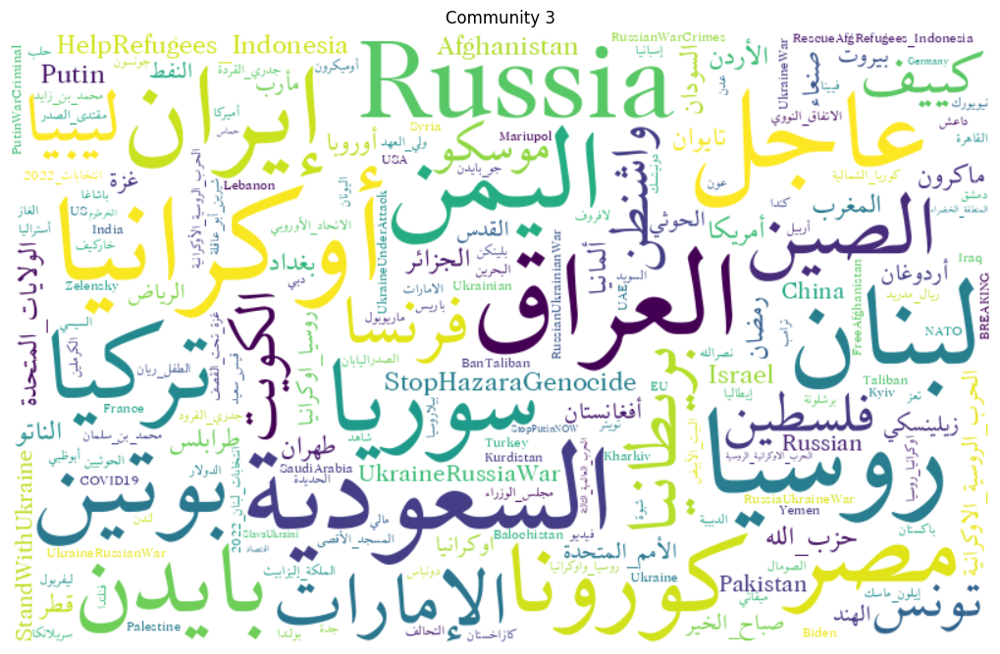

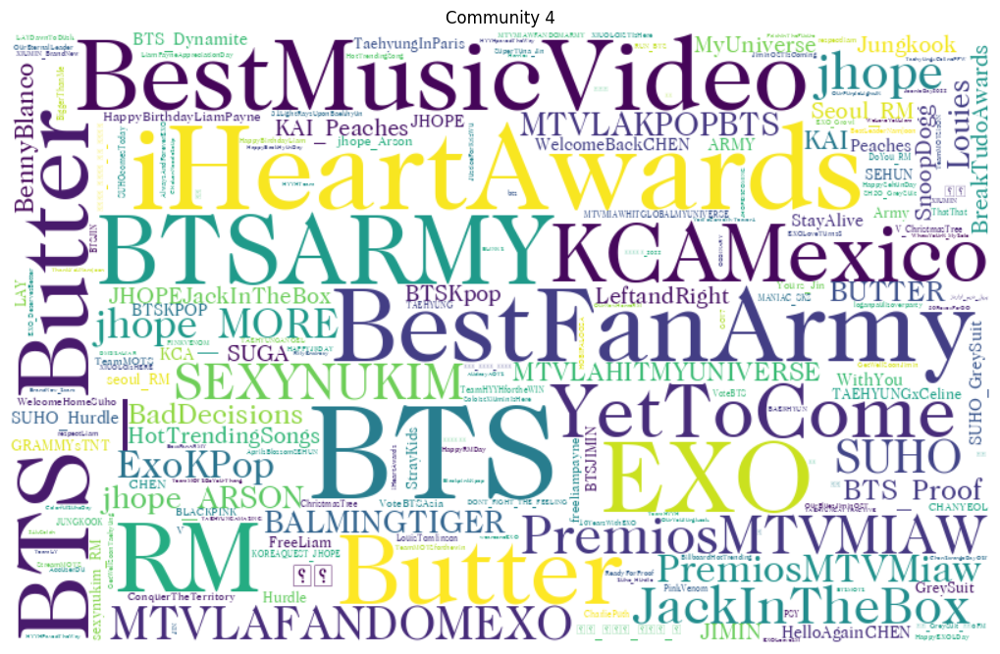

...

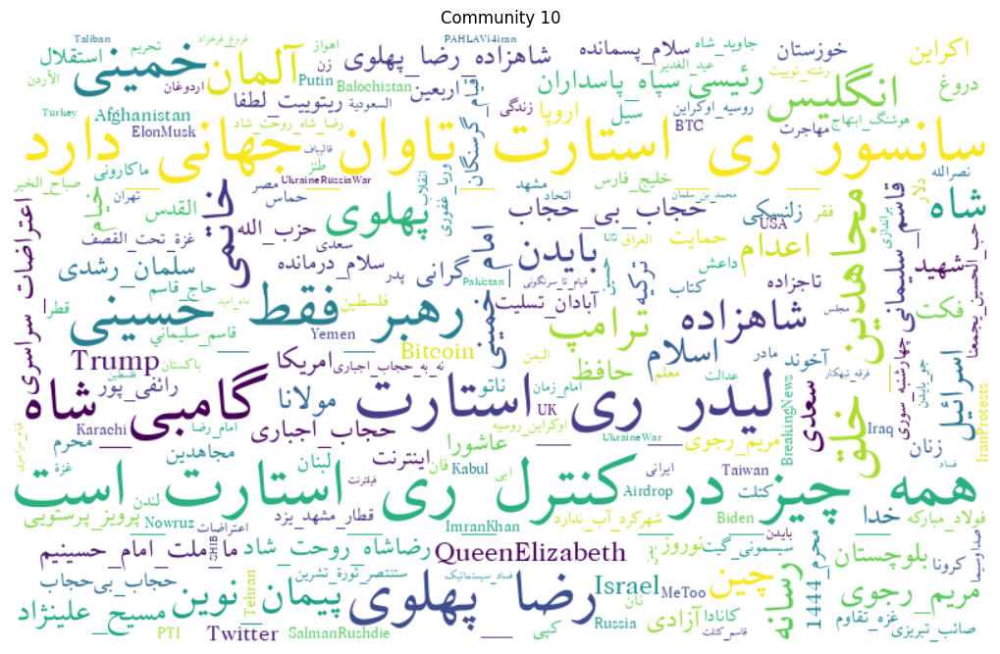

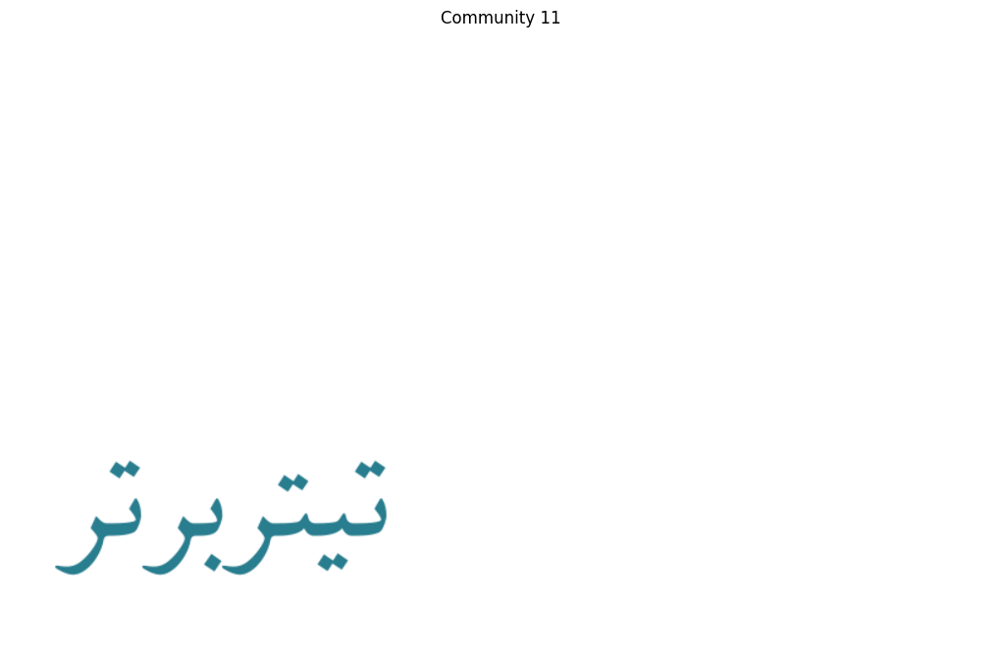

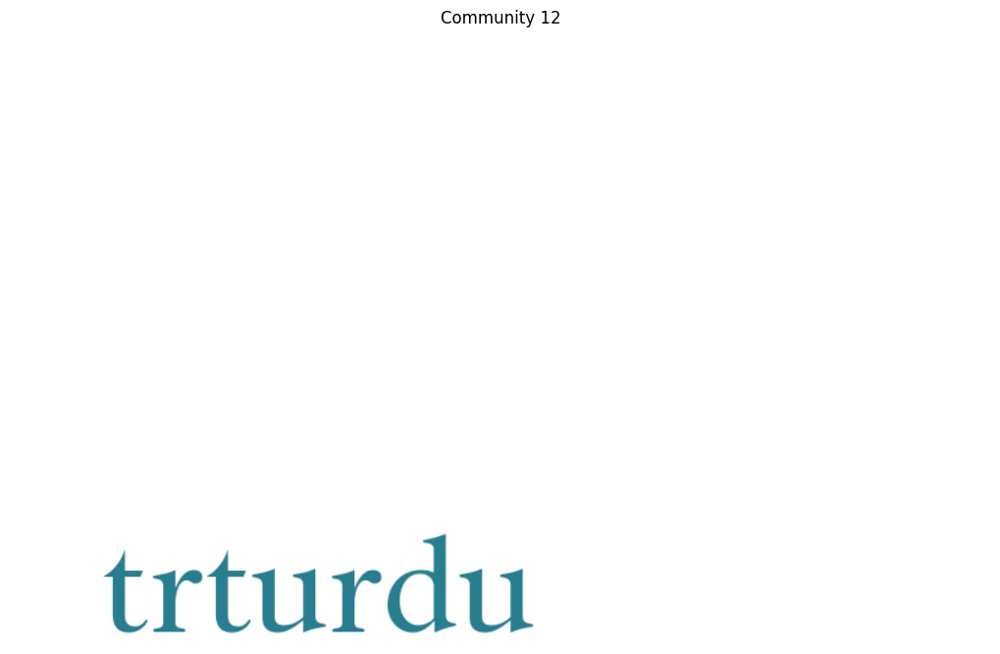

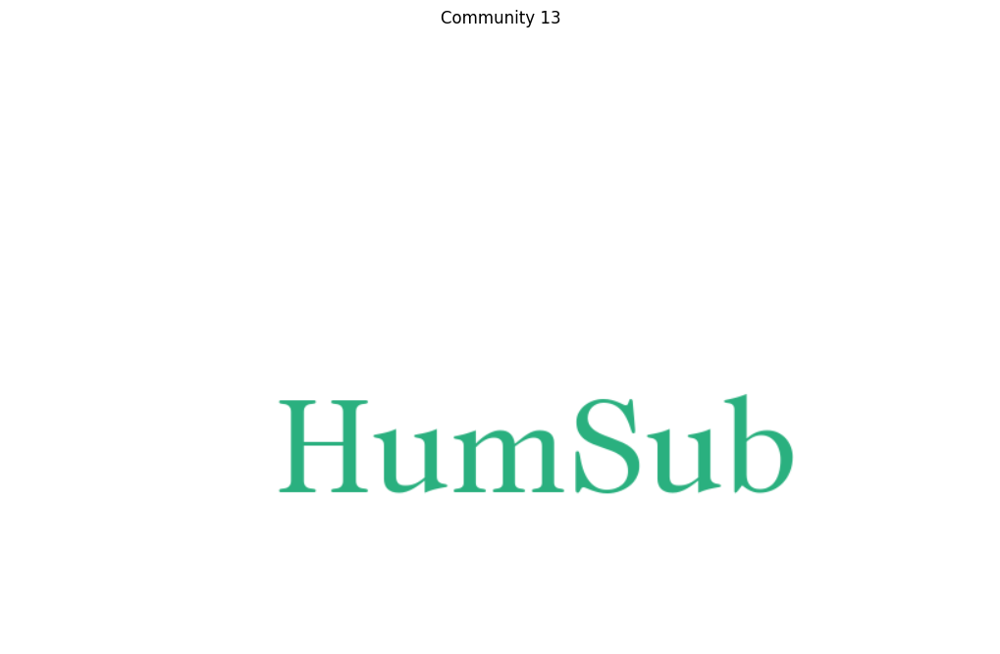

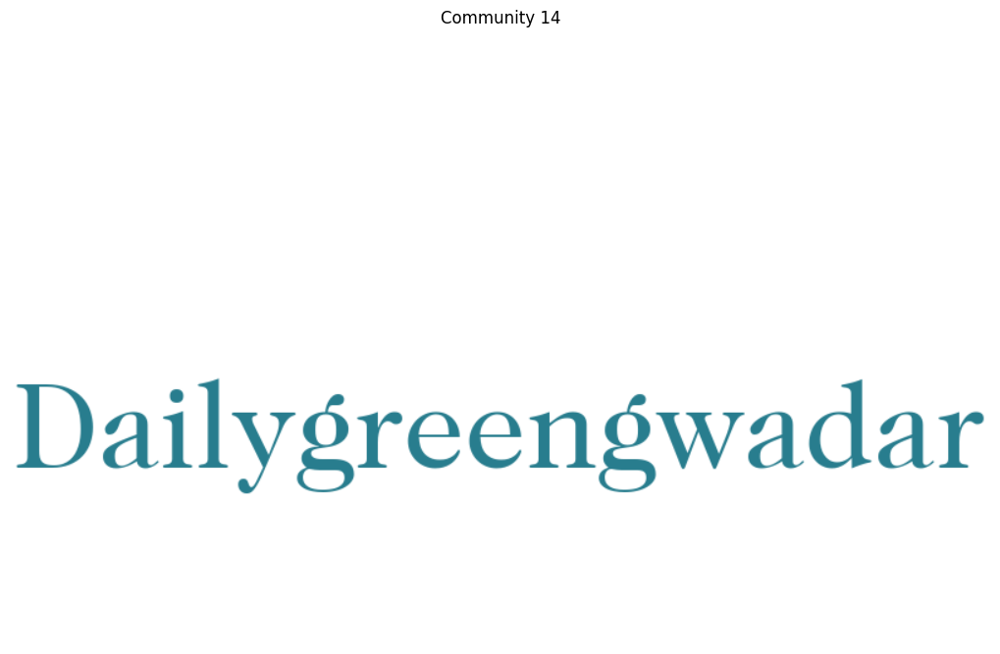

In [454]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib

matplotlib.rcParams["axes.unicode_minus"] = False
from bidi.algorithm import get_display
import arabic_reshaper

#df = df_after

# assuming `df` is your DataFrame and it has a 'community' column
for community in sorted(df["community"].unique()):
    subset = df[df["community"] == community]
    # print(subset.columns)
    # #freq = subset.groupby("hashtag").count() 
    # # text = get_display(arabic_reshaper.reshape(text))
    # print(subset.head())
    # if subset.empty:
    #     print(f"No hashtags for community {community}. Skipping...")
    #     continue

    freq = subset.groupby("hashtag")["count"].nunique().sort_values(ascending=False)
    # print(freq)
    wordcloud = WordCloud(
        font_path="/usr/share/fonts/TTF/XB-Zar-Regular.ttf",
        width=800,
        height=500,
        random_state=21,
        max_font_size=110,
        background_color="white",
    ).generate_from_frequencies(freq)

    plt.figure(figsize=(10, 7))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Community {community}")
    # plt.show()
    save_cloud_path = os.path.join( env["plots"], "analysis", "community0_finetune", f"community_{community}.png")

    if not os.path.exists(os.path.dirname(save_cloud_path)):
        os.makedirs(os.path.dirname(save_cloud_path))

    # tight_layout() adjusts the subplot params so that the subplot(s) fits in to the figure area.
    plt.tight_layout()

    # remove the extra white space on the right side of the plot
    plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)
    
    plt.show()
    #plt.savefig(save_cloud_path)

In [291]:
# Group the data by community and hashtag and count the number of unique users for each combination
community_hashtag_users = df.groupby(['community', 'hashtag'])['user_id'].nunique().reset_index(name='unique_users')

# Calculate the total number of unique users in each community
community_users = df.groupby('community')['user_id'].nunique()

# Calculate the total number of unique users for each hashtag
hashtag_users = df.groupby('hashtag')['user_id'].nunique()

# Create a pivot table where rows are hashtags and columns are communities.
pivot_table = df.pivot_table(values='user_id', index='hashtag', columns='community', aggfunc=pd.Series.nunique, fill_value=0)

# Calculate proportions by dividing by the total unique users in each community.
proportion_table = pivot_table.divide(community_users, axis=1)

# Calculate the proportion of unique hashtag users in each community
community_hashtag_users['proportion_in_community'] = community_hashtag_users.apply(lambda row: proportion_table.loc[row['hashtag'], row['community']], axis=1)

# Calculate the maximum proportion in other communities
community_hashtag_users['proportion_in_other_communities'] = community_hashtag_users.apply(lambda row: proportion_table.loc[row['hashtag']].drop(row['community']).max(), axis=1)

# Select the top hashtags in each community based on unique users
top_hashtags = community_hashtag_users.groupby('community').apply(lambda group: group.nlargest(2000, 'unique_users'))


In [305]:
exclusive_hashtags = top_hashtags[(top_hashtags['proportion_in_community'] > 0.001) & (top_hashtags['proportion_in_other_communities'] < 0.001)]

exclusive_hashtags[exclusive_hashtags['community'] == 6].head(1000)['hashtag'].values

array(['میتوان_و_باید', 'کانونهای_شورشی', 'WeStand4FreeIran',
       'دیپلمات_تروریست', 'آری_به_جمهوری_دمکراتیک', 'FreeIranTelethon',
       'ProsecuteRaisiNOW', 'همیاری', 'انحلال_سپاه_پاسداران',
       'درود_بر_مجاهد', 'WeSupportMEK', 'منوچهر_هزارخانی',
       'روز_حساب_نزدیکه', 'ShutdownIranTerrorEmbassies',
       'WomenForce4Change', 'MEKResistanceUnits', 'Westand4FreeIran',
       'NoImpunity4Mullahs', 'قضاییه_جلادان', 'NCRIAlternative',
       'سیمای_آزادی', 'مجاهدین_خلق_ایران', 'صحيفة_اليوم',
       'مستقبل_الإعلام_يبدأ_من_اليوم', 'قناة_الغد', 'العربيه_فارسى',
       'AlGhadStory', 'ورزشی', 'اليوم_الثامن', 'بک_دهندگان',
       'ليفانت_نيوز'], dtype=object)